# Raw Data vs PCA

**Index**:
- [Ensembles](#Ensembles)
    - [Preprocessing](#preprocessing-of-the-ensemble-results)
    - [Analysis of the results](#Analysis-of-the-ensemble-results)
        - [General plots](#General-plots-for-the-ensemble-results)
        - [Plots per class](#Plots-for-the-ensemble-results-per-class)
        - [General table](#General-table-for-the-ensemble-results)
        - [Table per class](#Tables-per-class-for-the-ensemble-results)
- [Base models](#Base-models)
    - [Preprocessing](#Preprocessing-of-the-base-models-results)
    - [ANN](#ANN)
    - [Scikit ANN](#Scikit-ANN)
    - [Decision Tree](#Decision-Tree)
    - [K-Nearest Neighbors](#K-Nearest-Neighbors)
    - [Support Vector Machine](#Support-Vector-Machine)

In [23]:
using Serialization
using DataStructures

In [24]:
include("plotting.jl")

generateComparisonTable (generic function with 2 methods)

## Ensembles

### Preprocessing of the ensemble results

Load the results of first approach:

In [25]:
results_folder = "results/"
filename_1 = results_folder * "1_ensemble_results.jl"

# Load the results
approach1_obj = open(filename_1, "r") do file
  deserialize(file)
end

Dict{Symbol, Dict{String, Any}} with 3 entries:
  :Voting_Hard => Dict("class_results"=>[Dict(:recall=>[0.877439, 0.904652, 0.9…
  :Voting_Soft => Dict("class_results"=>[Dict(:recall=>[0.870088, 0.793015, 0.7…
  :Stacking    => Dict("class_results"=>[Dict(:recall=>[0.783158, 0.780282, 0.9…

The same for the second approach:

In [26]:
filename_2 = results_folder * "2_ensemble_results.jl"

# Load the results
approach2_obj = open(filename_2, "r") do file
  deserialize(file)
end

Dict{Symbol, Dict{String, Any}} with 3 entries:
  :Voting_Hard => Dict("class_results"=>[Dict(:recall=>[0.740351, 0.804483, 0.7…
  :Voting_Soft => Dict("class_results"=>[Dict(:recall=>[0.777053, 0.863052, 0.7…
  :Stacking    => Dict("class_results"=>[Dict(:recall=>[0.762807, 0.809416, 0.7…

Now, let's put in the same object the results of both approaches:

In [27]:
loaded_obj = OrderedDict(
    :Voting_Soft_Raw => approach1_obj[:Voting_Soft],
    :Voting_Soft_PCA => approach2_obj[:Voting_Soft],
    :Voting_Hard_Raw => approach1_obj[:Voting_Hard],
    :Voting_Hard_PCA => approach2_obj[:Voting_Hard],
    :Stacking_Raw => approach1_obj[:Stacking],
    :Stacking_PCA => approach2_obj[:Stacking],
)

OrderedDict{Symbol, Dict{String, Any}} with 6 entries:
  :Voting_Soft_Raw => Dict("class_results"=>[Dict(:recall=>[0.870088, 0.793015,…
  :Voting_Soft_PCA => Dict("class_results"=>[Dict(:recall=>[0.777053, 0.863052,…
  :Voting_Hard_Raw => Dict("class_results"=>[Dict(:recall=>[0.877439, 0.904652,…
  :Voting_Hard_PCA => Dict("class_results"=>[Dict(:recall=>[0.740351, 0.804483,…
  :Stacking_Raw    => Dict("class_results"=>[Dict(:recall=>[0.783158, 0.780282,…
  :Stacking_PCA    => Dict("class_results"=>[Dict(:recall=>[0.762807, 0.809416,…

In [28]:
model_names, metrics, metric_means, metric_stds, metric_means_class, metric_stds_class, metric_maxes, metric_maxes_class = aggregateMetrics(loaded_obj, 3, ensemble=true)

(Any["Voting_Soft_Raw", "Voting_Soft_PCA", "Voting_Hard_Raw", "Voting_Hard_PCA", "Stacking_Raw", "Stacking_PCA"], [:accuracy, :precision, :recall, :f1_score], Dict{Symbol, Vector{Any}}(:recall => [0.7682166554132766, 0.7534822272044394, 0.7664042410440801, 0.7567805913010593, 0.7696621124052715, 0.758448971692311], :f1_score => [0.7530429190958778, 0.7346587600974366, 0.7471990688272785, 0.738443785452601, 0.7581925002767683, 0.7454592755188433], :precision => [0.754577100244893, 0.7379606802557795, 0.7512582002067012, 0.7416138000701873, 0.7570294820628011, 0.7436684926272055], :accuracy => [0.8464240448629162, 0.8348181888400734, 0.8446466856790236, 0.8370306357446593, 0.8481344398430334, 0.8399729468694064]), Dict{Symbol, Vector{Any}}(:recall => [0.008876155003997178, 0.007495767222414446, 0.008639165652528652, 0.008835809801661534, 0.00790772068331056, 0.011266020775829411], :f1_score => [0.008933379661860174, 0.0073303598749102925, 0.010048890498821232, 0.008789364958470347, 0.009

### Analysis of the ensemble results

#### General plots for the ensemble results

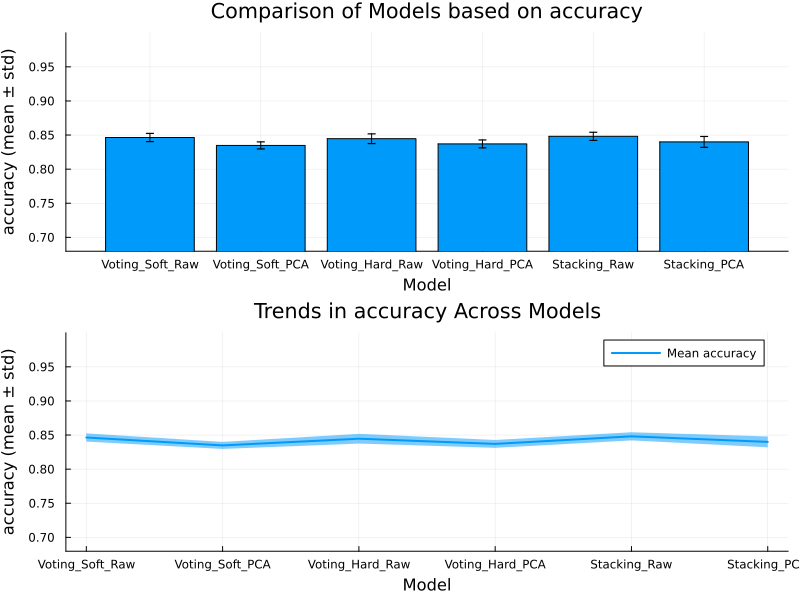

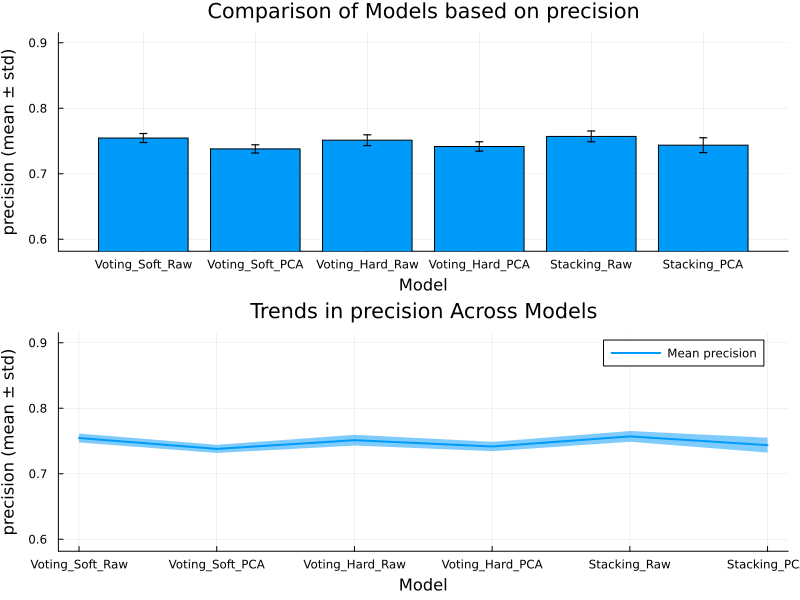

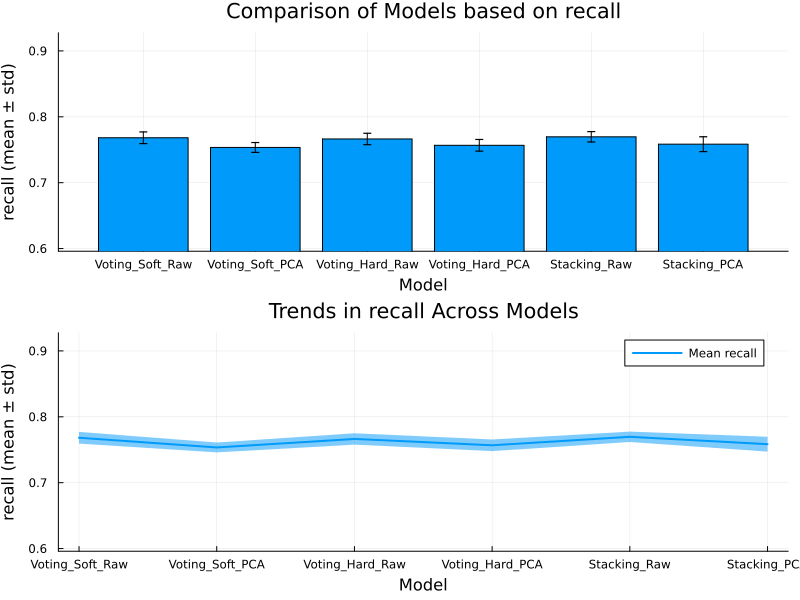

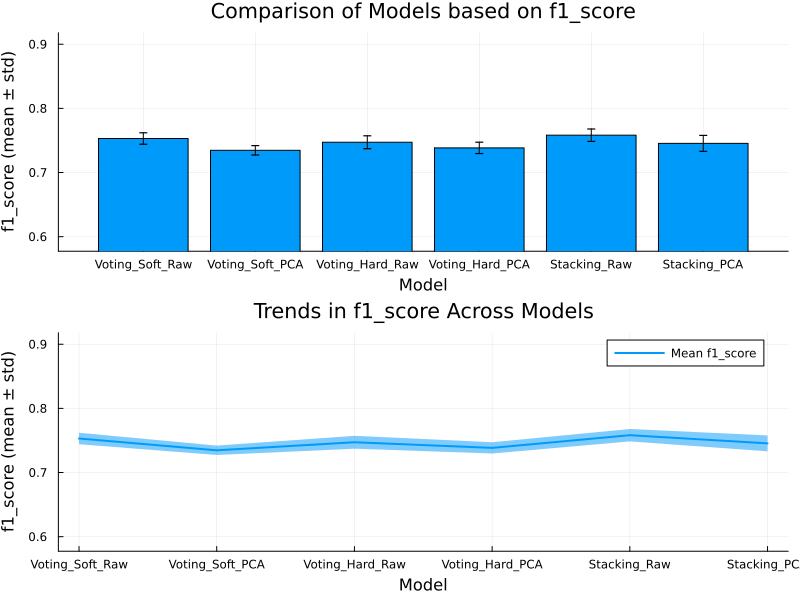

In [29]:
plotCombinedMetrics(model_names, metrics, metric_means, metric_stds, output_dir="./plots/Comparison_1_2/ensembles", show=true)

#### Plots per class for the ensemble results

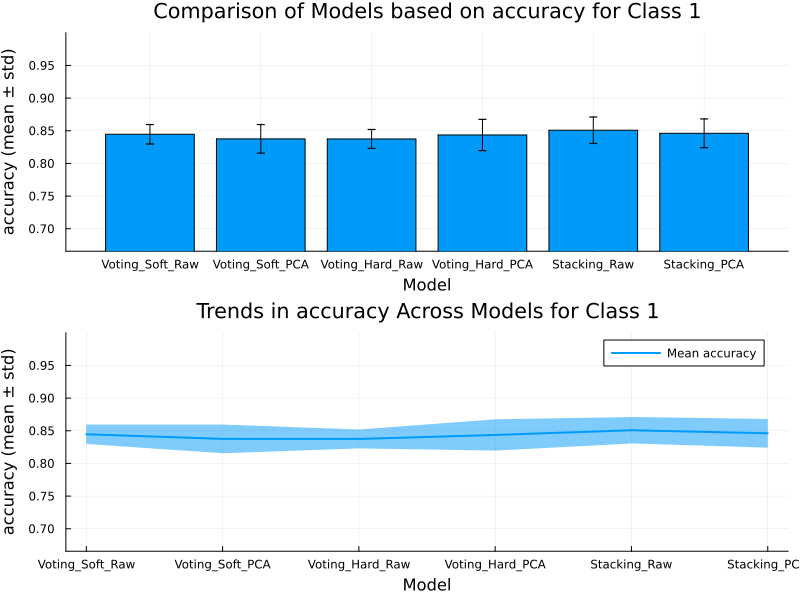

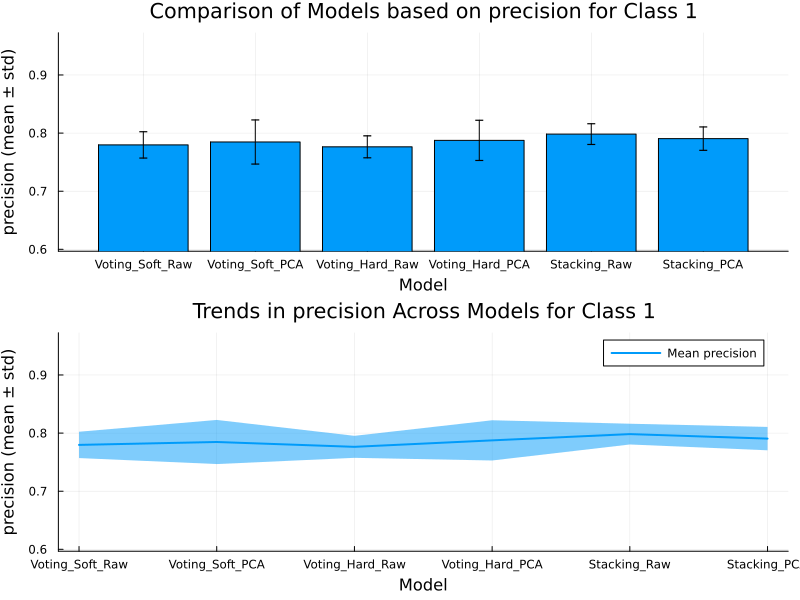

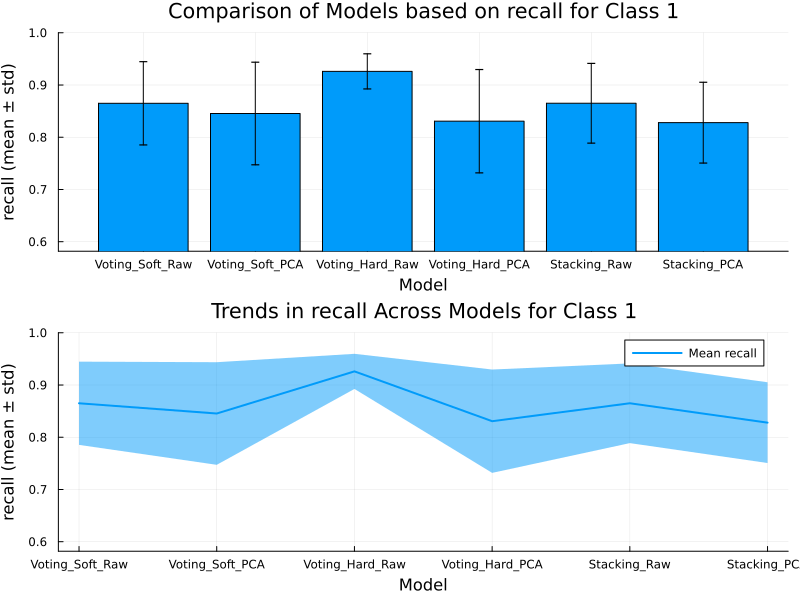

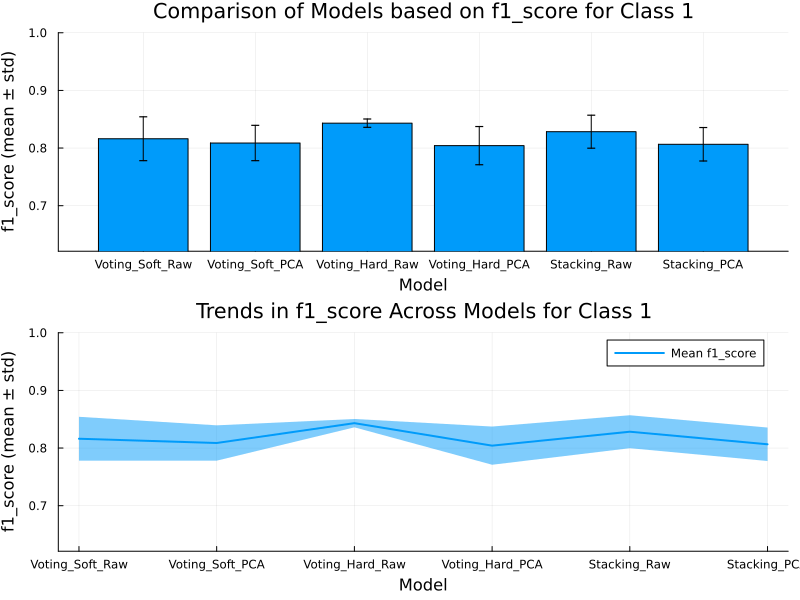

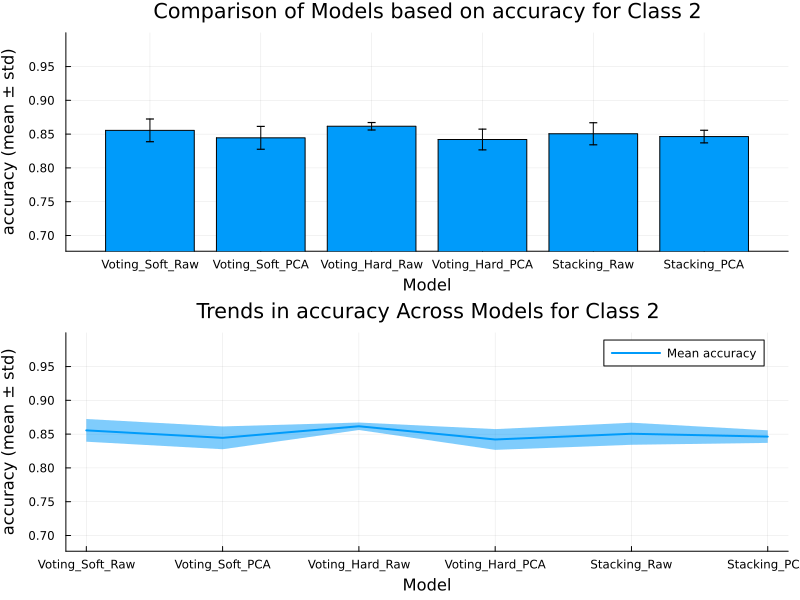

...

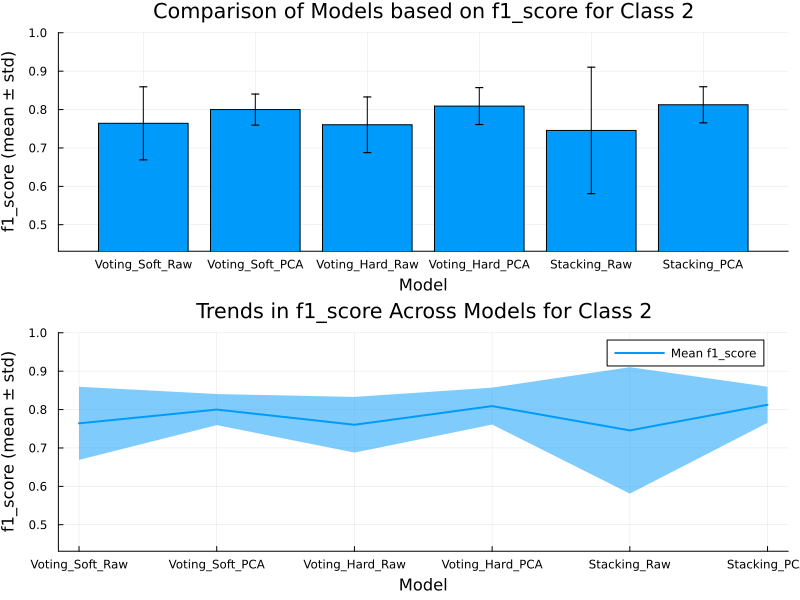

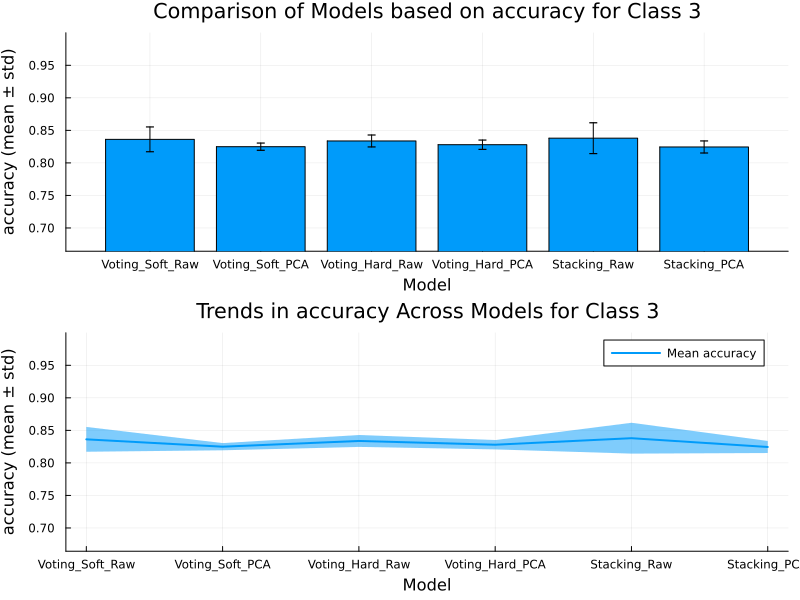

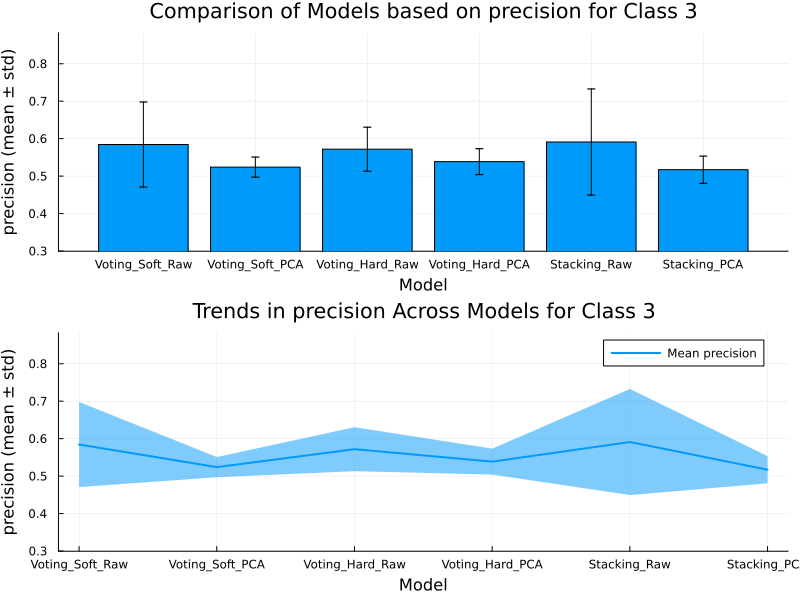

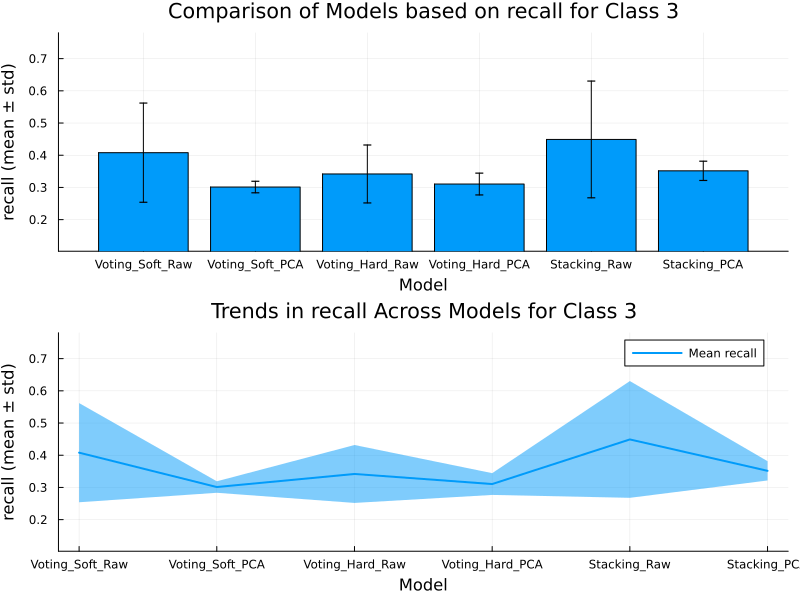

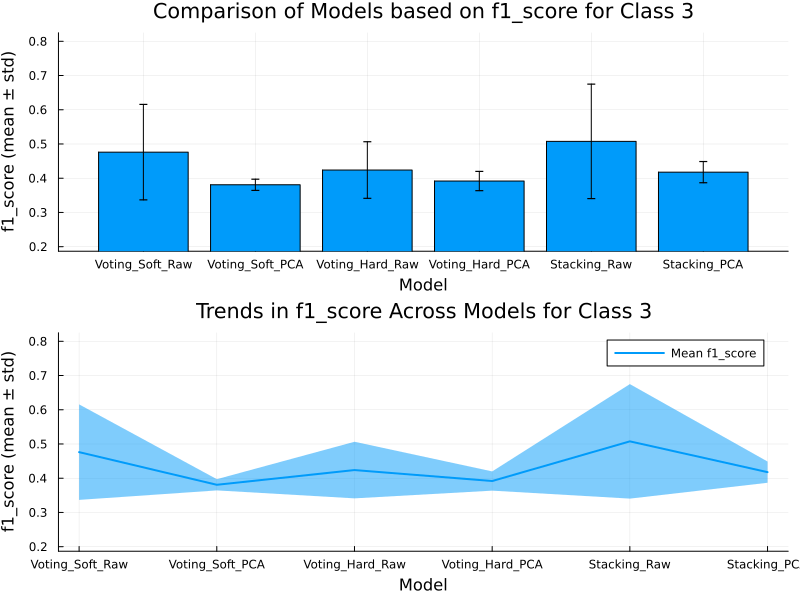

In [30]:
plotCombinedMetrics(model_names, 3, metrics, metric_means_class, metric_stds_class, output_dir="./plots/Comparison_1_2/ensembles/class", show=true)

#### General table for the ensemble results

In [31]:
generateComparisonTable(model_names, metrics, metric_maxes; output_dir="./tables/Comparison_1_2/ensembles", sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models (Sorted by f1_score):
┌─────────────────┬──────────┬───────────┬────────┬──────────┐
│           Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────────────┼──────────┼───────────┼────────┼──────────┤
│    Stacking_Raw │    0.853 │     0.766 │  0.777 │    0.767 │
│ Voting_Soft_Raw │    0.852 │     0.763 │  0.777 │    0.763 │
│    Stacking_PCA │    0.848 │     0.756 │  0.769 │    0.758 │
│ Voting_Hard_Raw │    0.853 │      0.76 │  0.777 │    0.757 │
│ Voting_Hard_PCA │    0.841 │     0.747 │  0.762 │    0.747 │
│ Voting_Soft_PCA │    0.838 │     0.743 │  0.758 │     0.74 │
└─────────────────┴──────────┴───────────┴────────┴──────────┘


#### Tables per class for the ensemble results

In [32]:
generateComparisonTable(model_names, 3, metrics, metric_maxes_class; output_dir ="./tables/Comparison_1_2/ensembles/class", sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models for Class 1 (Sorted by f1_score):
┌─────────────────┬──────────┬───────────┬────────┬──────────┐
│           Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────────────┼──────────┼───────────┼────────┼──────────┤
│ Voting_Hard_Raw │    0.856 │     0.798 │  0.956 │    0.854 │
│    Stacking_Raw │    0.875 │     0.823 │  0.925 │    0.854 │
│ Voting_Soft_Raw │    0.862 │     0.809 │  0.943 │    0.847 │
│ Voting_Hard_PCA │    0.872 │     0.842 │  0.941 │    0.838 │
│    Stacking_PCA │    0.868 │     0.822 │  0.919 │    0.837 │
│ Voting_Soft_PCA │    0.867 │     0.847 │  0.943 │    0.836 │
└─────────────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 2 (Sorted by f1_score):
┌─────────────────┬──────────┬───────────┬────────┬──────────┐
│           Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────────────┼──────────┼───────────┼────────┼──────────┤
│    Stacking_Raw │    

## Base models

### Preprocessing of the base models results

Load the results of first approach:

In [33]:
results_folder = "results/"
filename_1 = results_folder * "1_individual_results.jl"

# Load the results
approach1_obj = open(filename_1, "r") do file
    deserialize(file)
end

Dict{Symbol, Dict{String, Any}} with 5 entries:
  :DT         => Dict("class_results"=>Any[[Dict(:recall=>[0.923077, 0.707746, …
  :KNN        => Dict("class_results"=>Any[[Dict(:recall=>[0.649123, 0.704225, …
  :SVM        => Dict("class_results"=>Any[[Dict(:recall=>[0.754386, 0.771127, …
  :scikit_ANN => Dict("class_results"=>Any[[Dict(:recall=>[0.836409, 0.831306, …
  :ANN        => Dict("class_results"=>Any[[Dict(:recall=>[0.788772, 0.800704, …

The same for the second approach:

In [34]:
filename_2 = results_folder * "2_individual_results.jl"

# Load the results
approach2_obj = open(filename_2, "r") do file
    deserialize(file)
end

Dict{Symbol, Dict{String, Any}} with 5 entries:
  :DT         => Dict("class_results"=>Any[[Dict(:recall=>[0.670175, 0.968326, …
  :KNN        => Dict("class_results"=>Any[[Dict(:recall=>[0.638596, 0.679577, …
  :SVM        => Dict("class_results"=>Any[[Dict(:recall=>[0.750877, 0.742958, …
  :scikit_ANN => Dict("class_results"=>Any[[Dict(:recall=>[0.815813, 0.78997, 0…
  :ANN        => Dict("class_results"=>Any[[Dict(:recall=>[0.8, 0.785563, 0.767…

Let's put together in the same object the results of the same base models:

In [35]:
ann_obj = OrderedDict(
    :ANN_Raw => approach1_obj[:ANN],
    :ANN_PCA => approach2_obj[:ANN]
)

scikit_ann_obj = OrderedDict(
    :Scikit_ANN_Raw => approach1_obj[:scikit_ANN],
    :Scikit_ANN_PCA => approach2_obj[:scikit_ANN]
)

knn_obj = OrderedDict(
    :KNN_Raw => approach1_obj[:KNN],
    :KNN_PCA => approach2_obj[:KNN]
)

svm_obj = OrderedDict(
    :SVM_Raw => approach1_obj[:SVM],
    :SVM_PCA => approach2_obj[:SVM]
)

dt_obj = OrderedDict(
    :DT_Raw => approach1_obj[:DT],
    :DT_PCA => approach2_obj[:DT]
)

OrderedDict{Symbol, Dict{String, Any}} with 2 entries:
  :DT_Raw => Dict("class_results"=>Any[[Dict(:recall=>[0.923077, 0.707746, 0.88…
  :DT_PCA => Dict("class_results"=>Any[[Dict(:recall=>[0.670175, 0.968326, 0.97…

### ANN

In [36]:
model_names, metrics, metric_means, metric_stds, metric_means_class, metric_stds_class, metric_maxes, metric_maxes_class = aggregateMetrics(ann_obj, 3)

(Any["ANN_Raw", "ANN_PCA"], [:accuracy, :precision, :recall, :f1_score], Dict{Symbol, Vector{Any}}(:recall => [0.7640709008213582, 0.7510132303667265], :f1_score => [0.7482606387409405, 0.7339436543130452], :precision => [0.7474072646899841, 0.7321354200947595], :accuracy => [0.8440325067839228, 0.8341778427949186]), Dict{Symbol, Vector{Any}}(:recall => [0.002993278706710152, 0.0020717277254062665], :f1_score => [0.005156520702365683, 0.003125599933999569], :precision => [0.004611654581763756, 0.0033120037158385135], :accuracy => [0.0024705110032482436, 0.0015429909016697035]), Dict{Symbol, Vector{Any}}[Dict(:recall => [0.7673407153446999, 0.7653700580677045], :f1_score => [0.7878264801806477, 0.7759490890043292], :precision => [0.8109194233238295, 0.7891290144310149], :accuracy => [0.8674240502064267, 0.8582020516895372]), Dict(:recall => [0.9192749022685998, 0.9033545084700547], :f1_score => [0.8484151708316061, 0.8366528202461345], :precision => [0.7879842379349518, 0.77947592819147

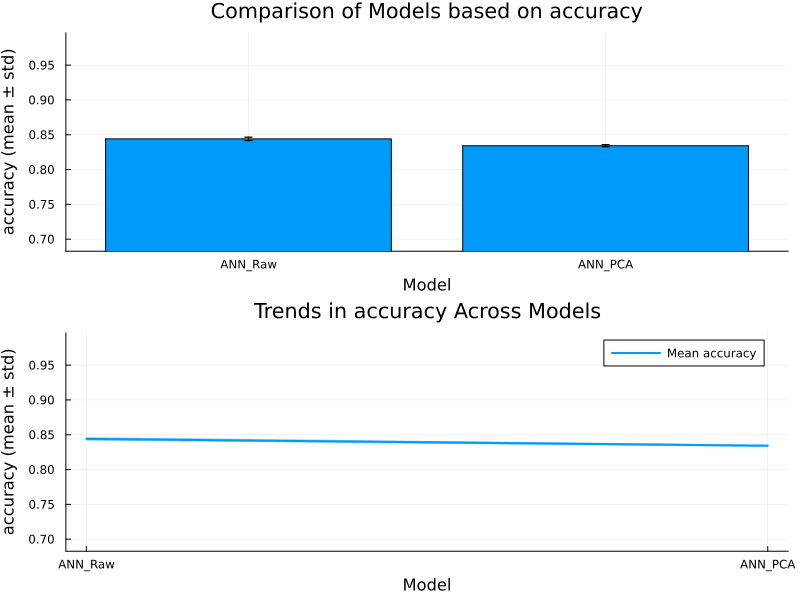

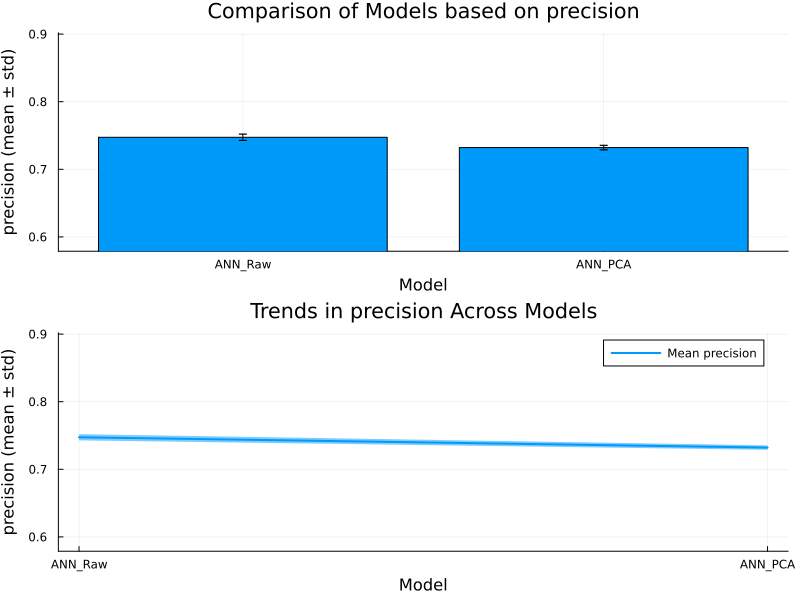

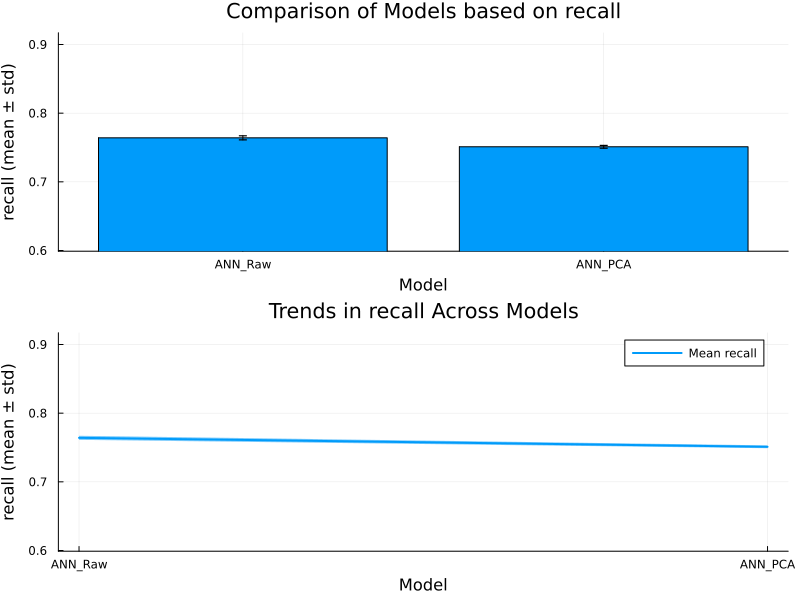

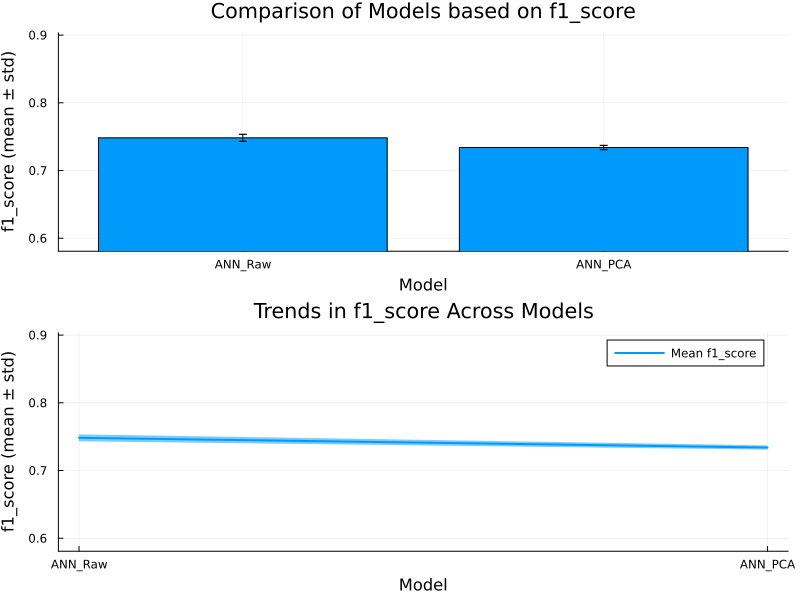

In [37]:
plotCombinedMetrics(model_names, metrics, metric_means, metric_stds, output_dir="./plots/Comparison_1_2/ann", show=true)

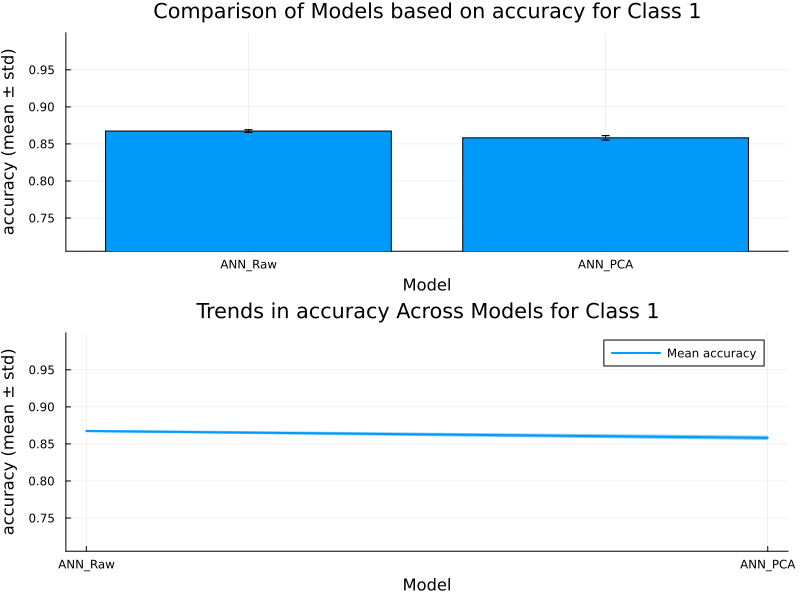

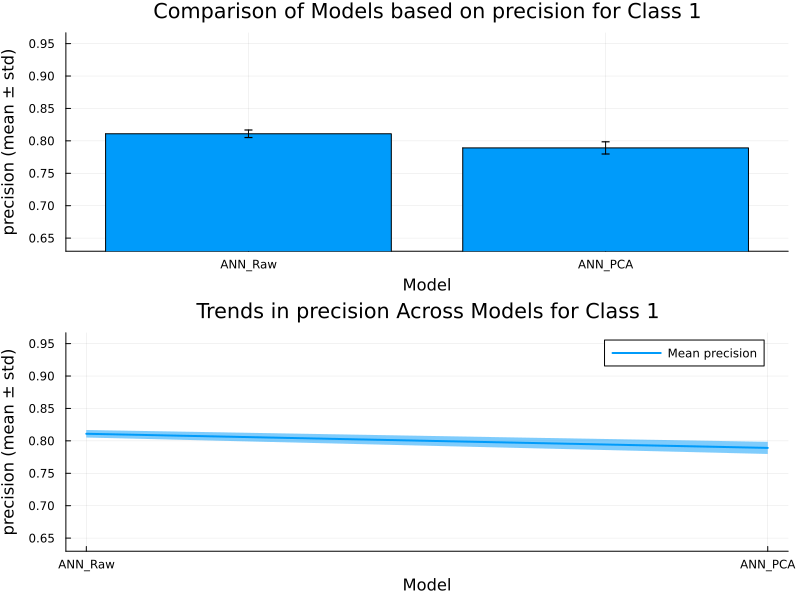

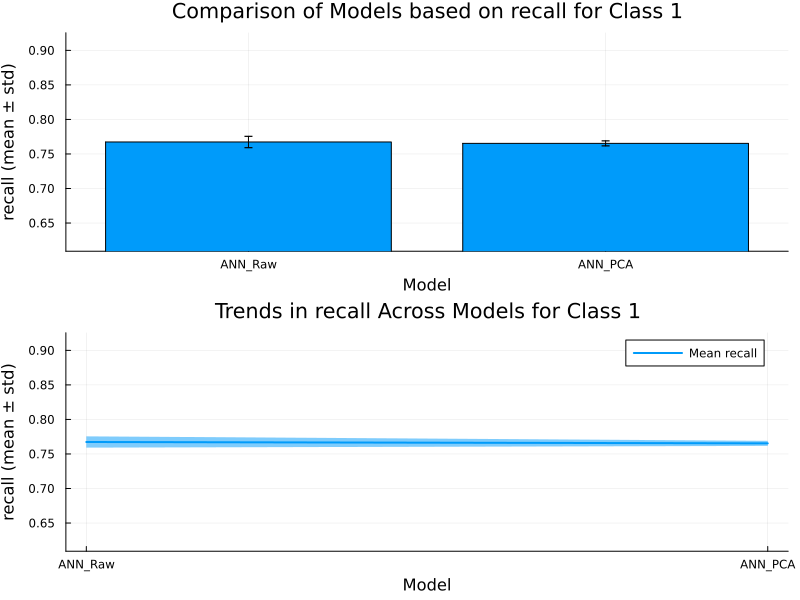

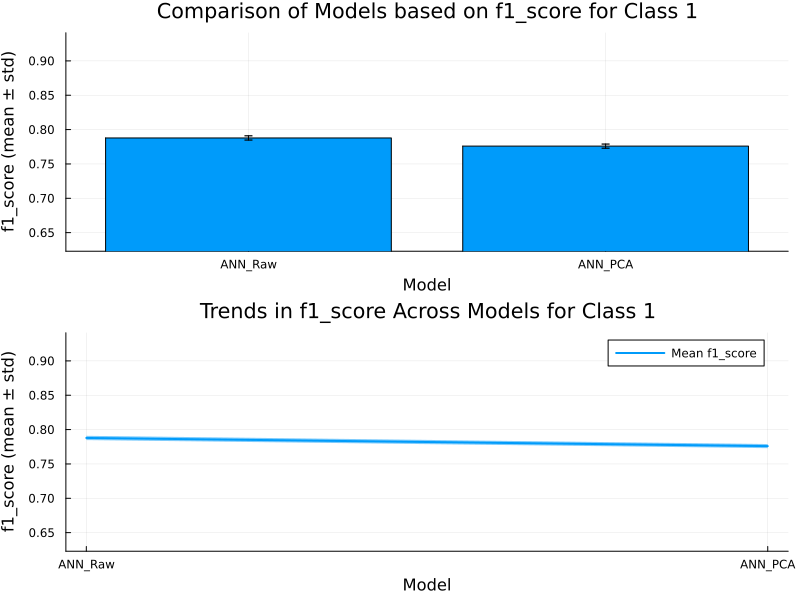

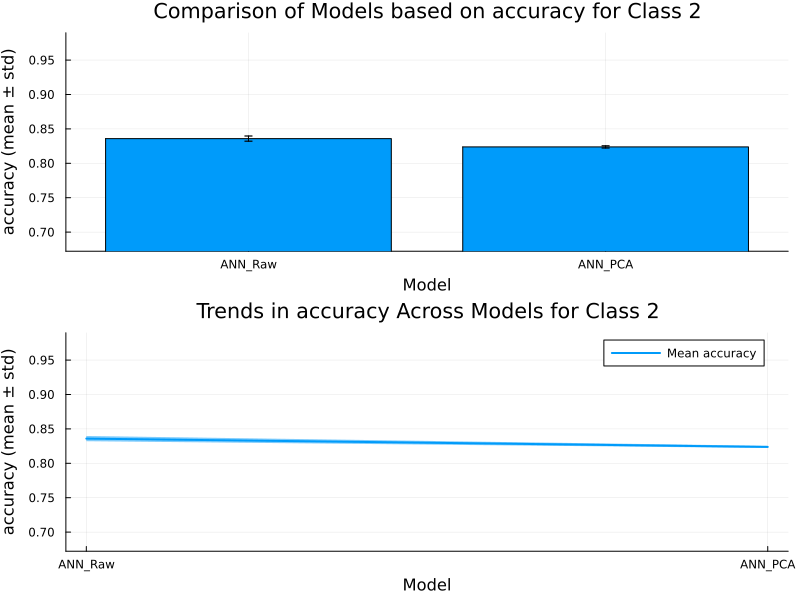

...

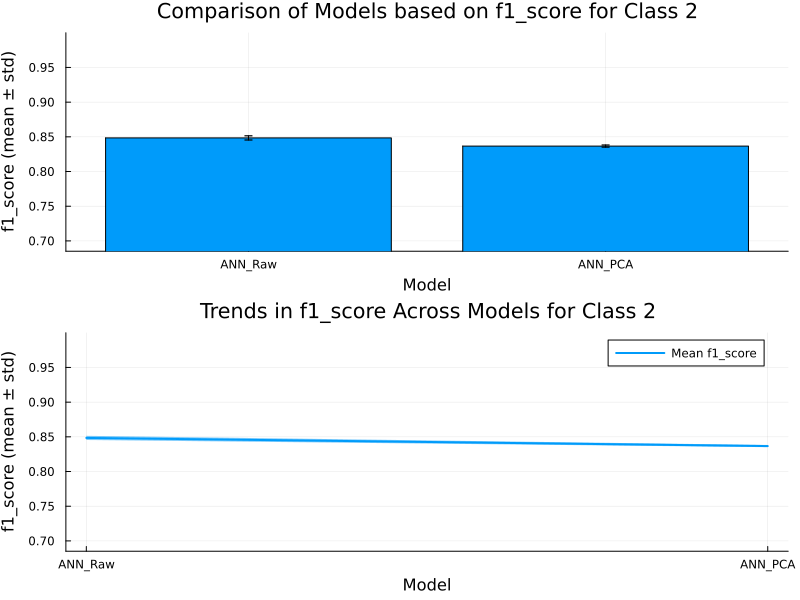

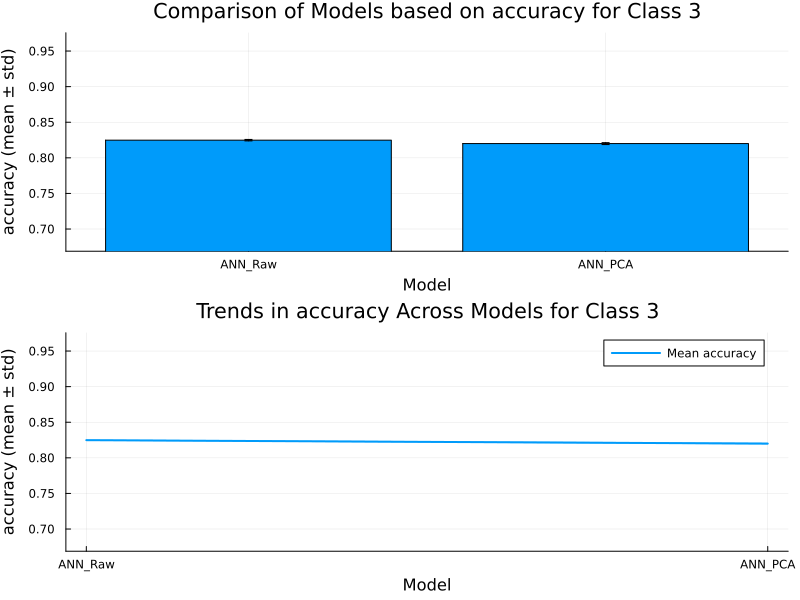

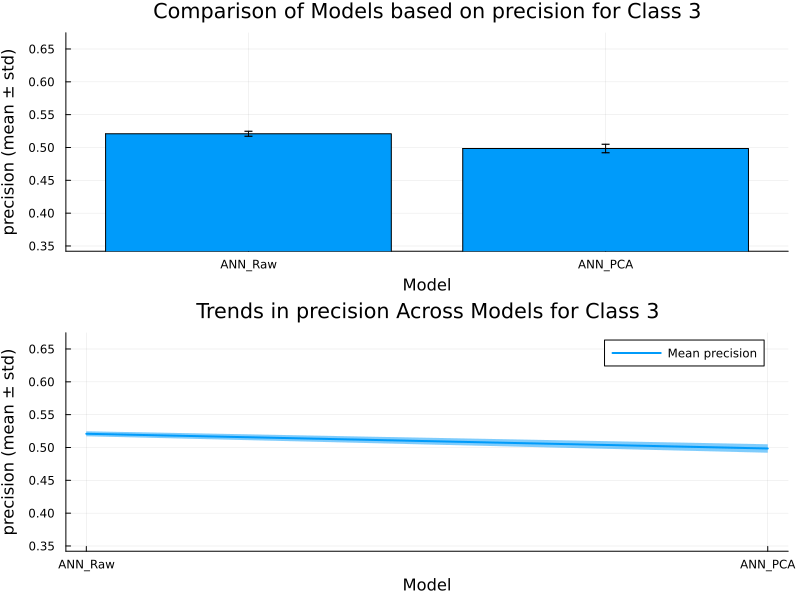

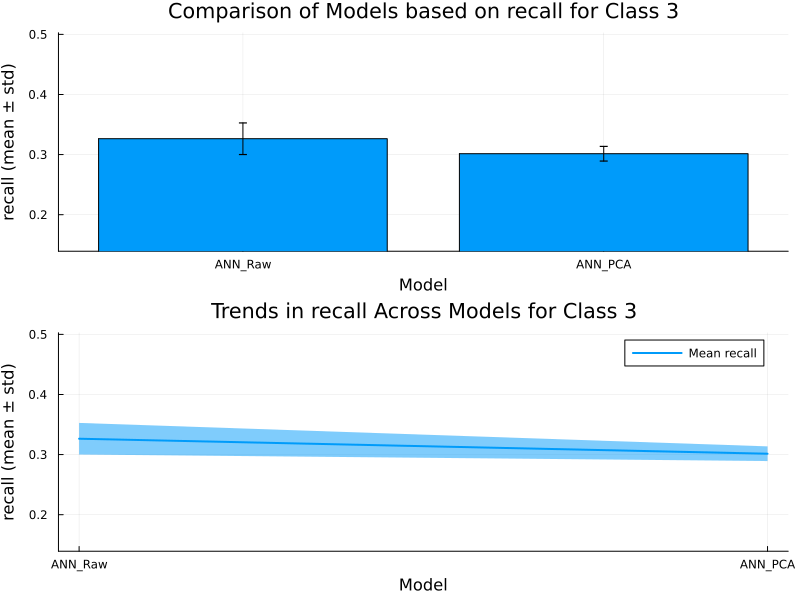

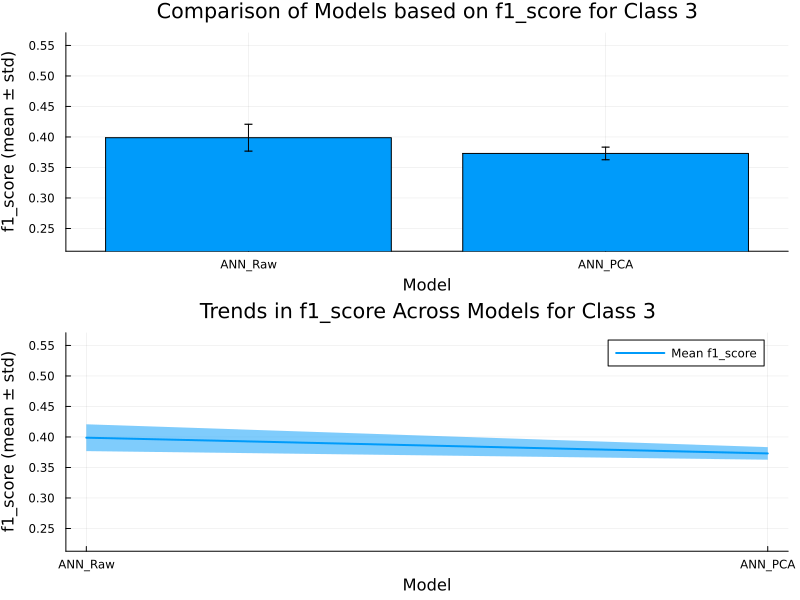

In [38]:
plotCombinedMetrics(model_names, 3, metrics, metric_means_class, metric_stds_class, output_dir="./plots/Comparison_1_2/ann/class", show=true)

In [39]:
generateComparisonTable(model_names, metrics, metric_maxes; output_dir="./tables/Comparison_1_2/ann",sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────┼──────────┼───────────┼────────┼──────────┤
│ ANN_Raw │    0.854 │     0.761 │  0.776 │    0.764 │
│ ANN_PCA │    0.847 │     0.751 │  0.767 │    0.753 │
└─────────┴──────────┴───────────┴────────┴──────────┘


In [40]:
generateComparisonTable(model_names, 3, metrics, metric_maxes_class; output_dir="./tables/Comparison_1_2/ann/class",sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models for Class 1 (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────┼──────────┼───────────┼────────┼──────────┤
│ ANN_Raw │    0.879 │     0.839 │  0.815 │    0.808 │
│ ANN_PCA │    0.875 │      0.83 │  0.816 │    0.797 │
└─────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 2 (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────┼──────────┼───────────┼────────┼──────────┤
│ ANN_Raw │    0.853 │     0.818 │  0.936 │    0.861 │
│ ANN_PCA │    0.839 │     0.809 │  0.924 │    0.851 │
└─────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 3 (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-S

### Scikit ANN

In [41]:
model_names, metrics, metric_means, metric_stds, metric_means_class, metric_stds_class, metric_maxes, metric_maxes_class = aggregateMetrics(scikit_ann_obj, 3)

(Any["Scikit_ANN_Raw", "Scikit_ANN_PCA"], [:accuracy, :precision, :recall, :f1_score], Dict{Symbol, Vector{Any}}(:recall => [0.7593074162658002, 0.7498320121053057], :f1_score => [0.7465128300407678, 0.7356970274686474], :precision => [0.7457652204463657, 0.7343336750172768], :accuracy => [0.8416340183203691, 0.8343694141890494]), Dict{Symbol, Vector{Any}}(:recall => [0.0011707919502644503, 0.000894969902855434], :f1_score => [0.0012063087318297154, 0.0013861728975099797], :precision => [0.0013228512349114003, 0.0014993526550299786], :accuracy => [0.0009046076627132421, 0.0006906575756257347]), Dict{Symbol, Vector{Any}}[Dict(:recall => [0.8536845612570579, 0.8366306009784594], :f1_score => [0.8173831004609485, 0.8050231755202553], :precision => [0.7885114486220635, 0.7804922476559496], :accuracy => [0.8450037050034279, 0.8388587593441665]), Dict(:recall => [0.7803704237339875, 0.8026392023462641], :f1_score => [0.7819185364419852, 0.7933824604477151], :precision => [0.7917759033312692,

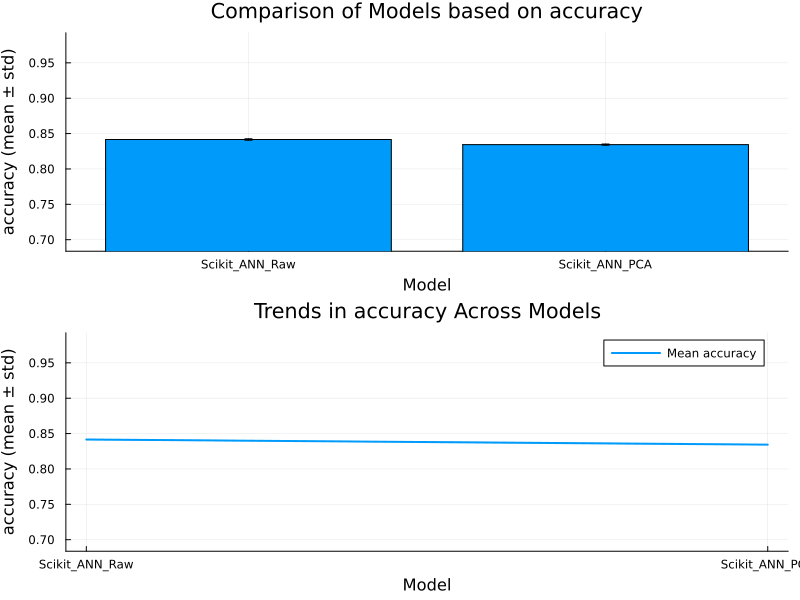

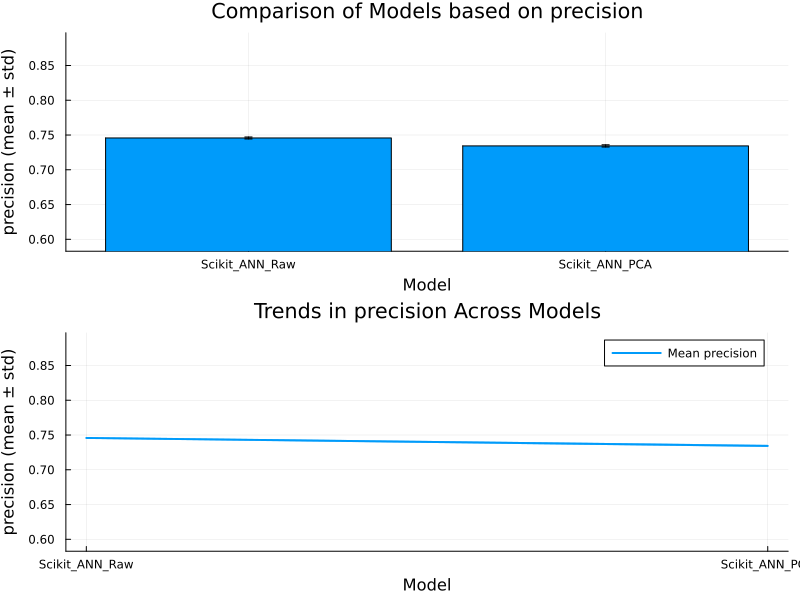

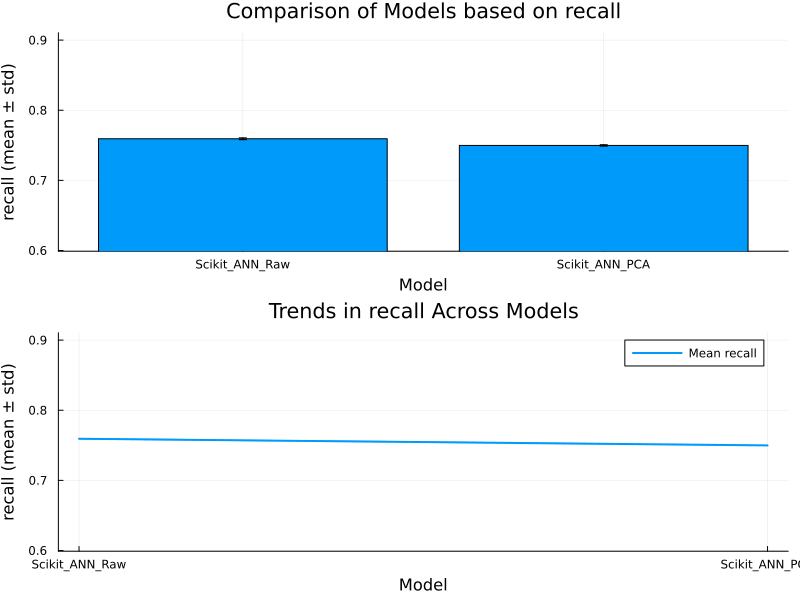

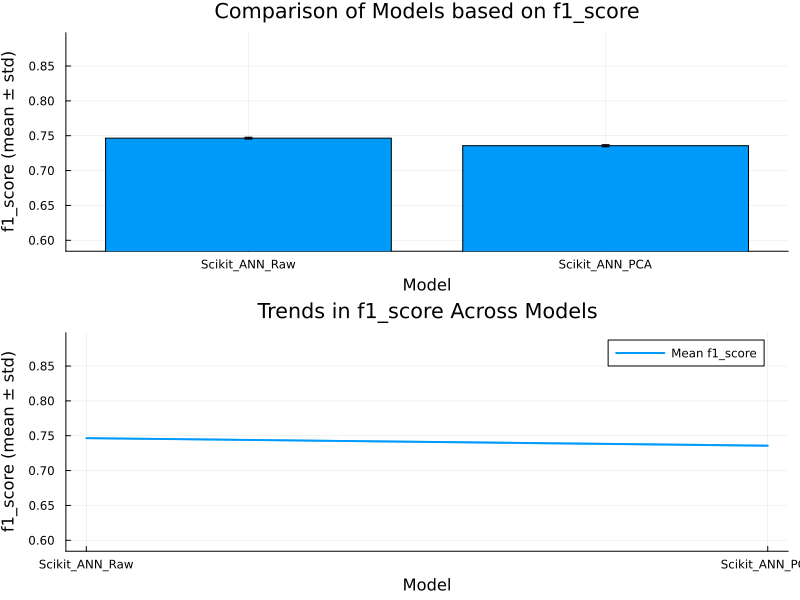

In [42]:
plotCombinedMetrics(model_names, metrics, metric_means, metric_stds, output_dir="./plots/Comparison_1_2/scikit_ann", show=true)

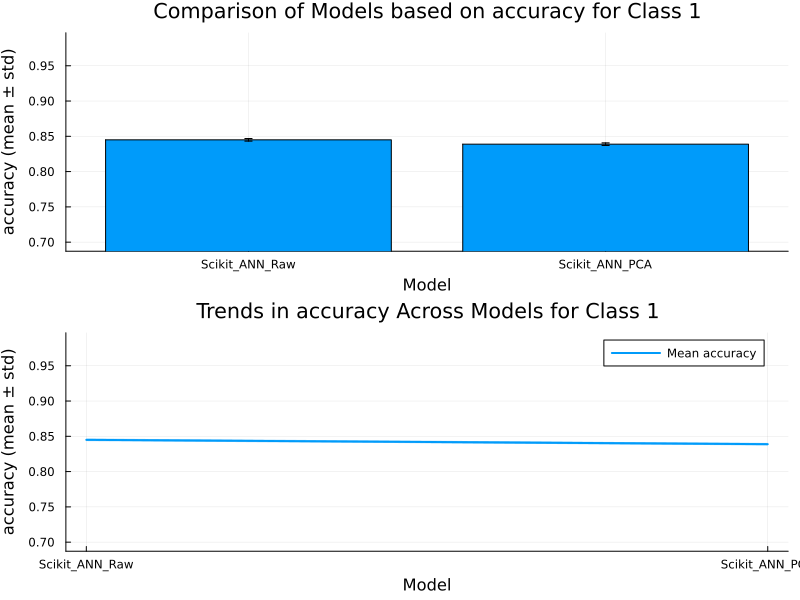

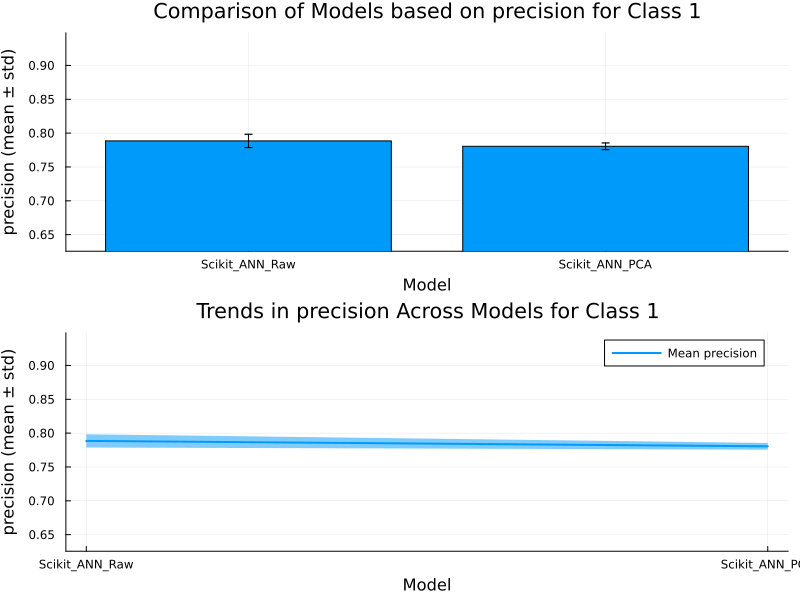

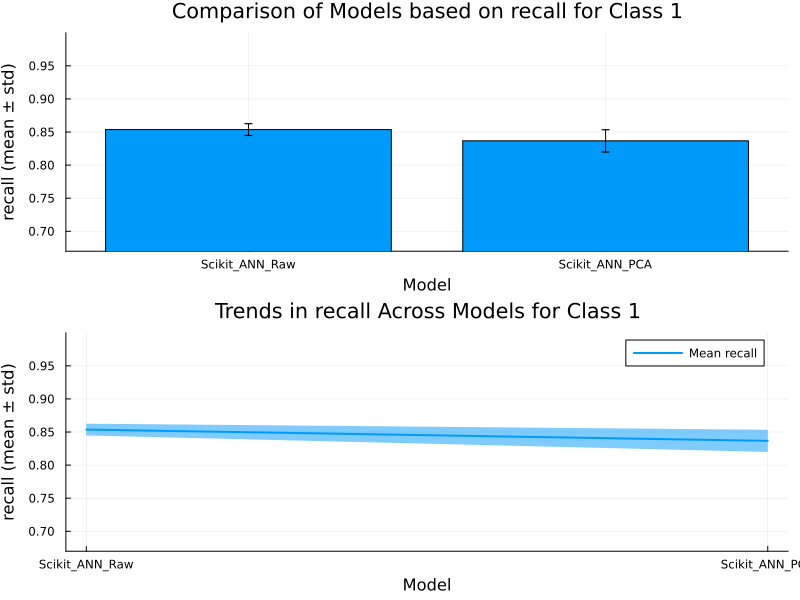

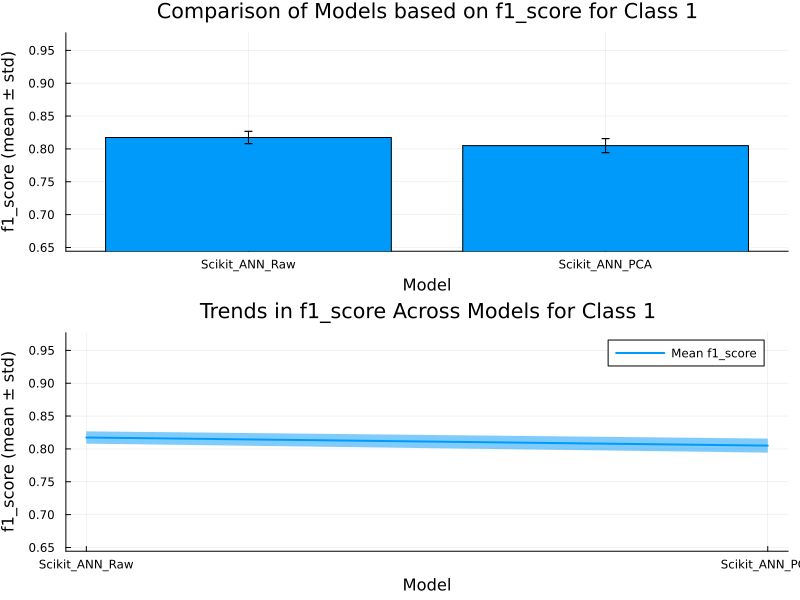

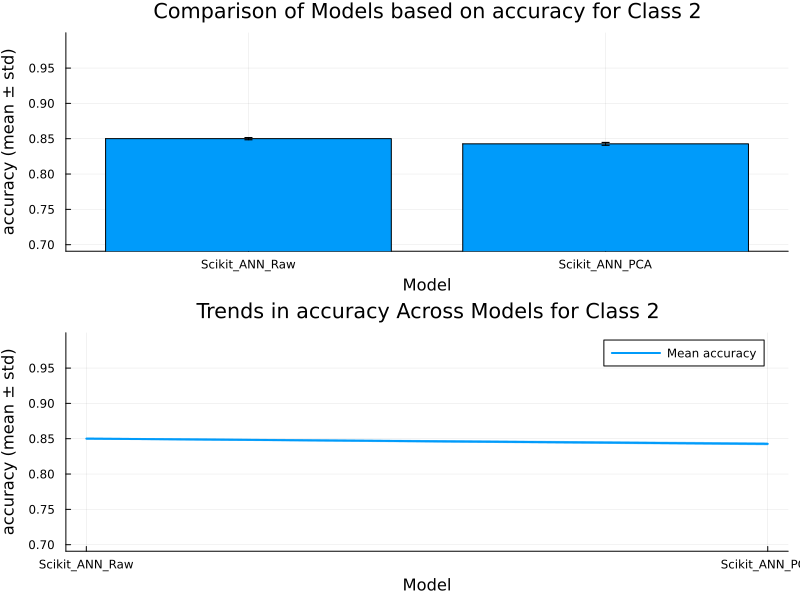

...

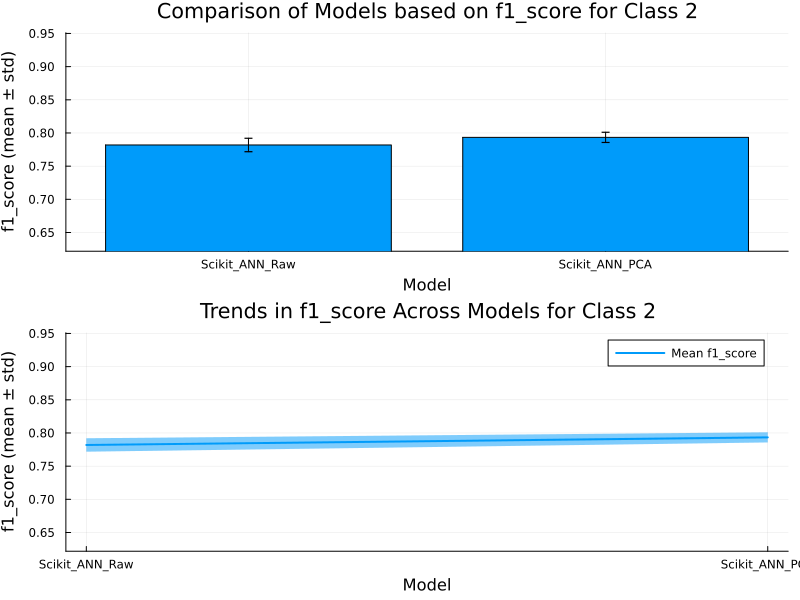

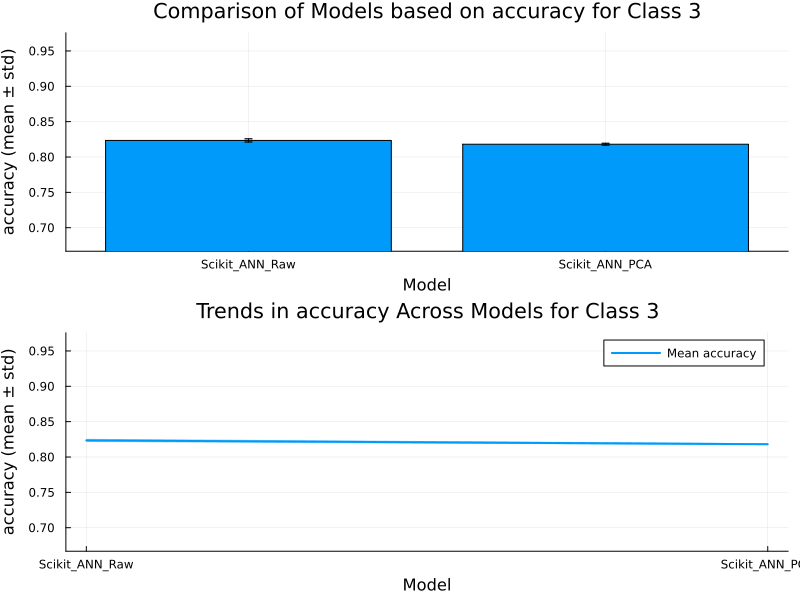

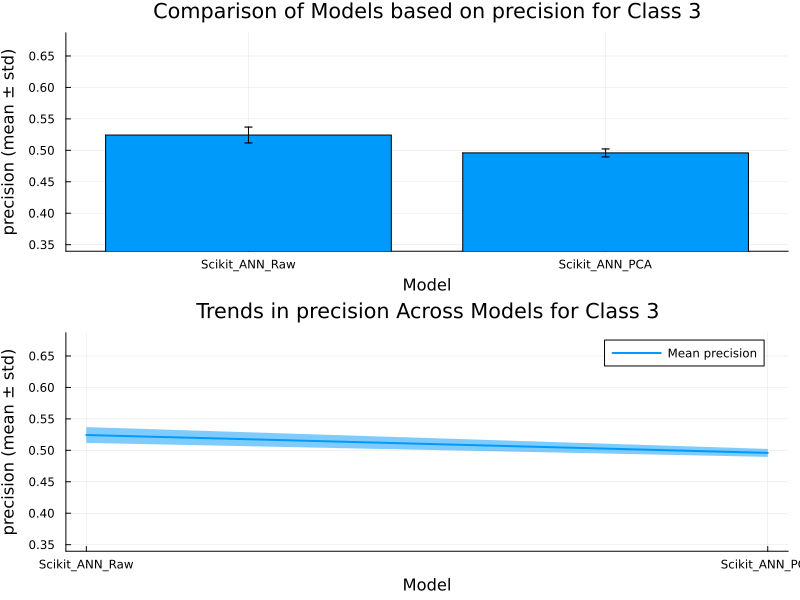

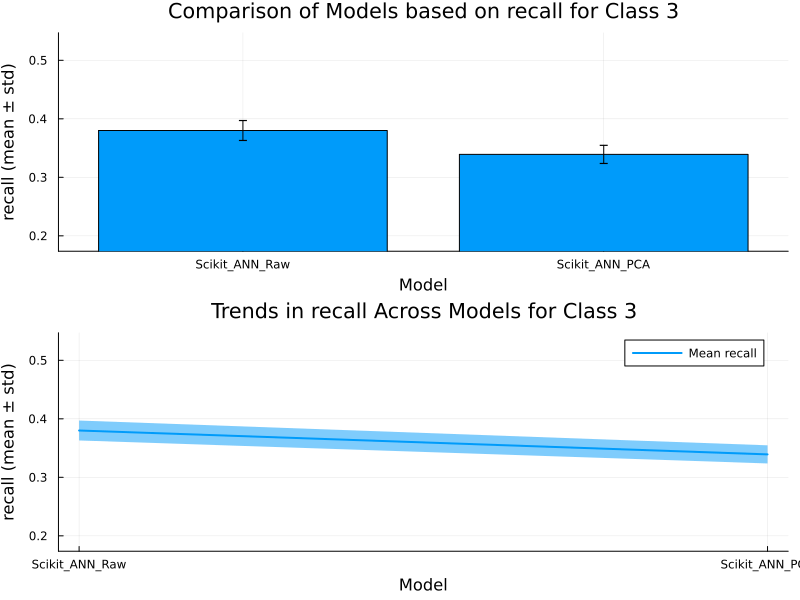

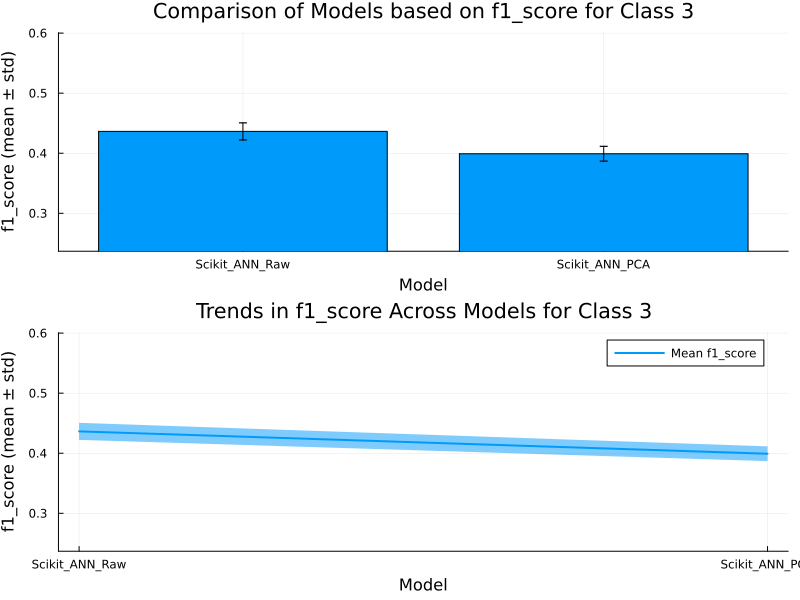

In [43]:
plotCombinedMetrics(model_names, 3, metrics, metric_means_class, metric_stds_class, output_dir="./plots/Comparison_1_2/scikit_ann/class", show=true)

In [44]:
generateComparisonTable(model_names, metrics, metric_maxes; output_dir="./tables/Comparison_1_2/scikit_ann",sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models (Sorted by f1_score):
┌────────────────┬──────────┬───────────┬────────┬──────────┐
│          Model │ Accuracy │ Precision │ Recall │ F1-Score │
├────────────────┼──────────┼───────────┼────────┼──────────┤
│ Scikit_ANN_Raw │    0.853 │     0.763 │  0.776 │    0.765 │
│ Scikit_ANN_PCA │    0.843 │      0.75 │  0.763 │    0.752 │
└────────────────┴──────────┴───────────┴────────┴──────────┘


In [45]:
generateComparisonTable(model_names, 3, metrics, metric_maxes_class; output_dir="./tables/Comparison_1_2/scikit_ann/class",sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models for Class 1 (Sorted by f1_score):
┌────────────────┬──────────┬───────────┬────────┬──────────┐
│          Model │ Accuracy │ Precision │ Recall │ F1-Score │
├────────────────┼──────────┼───────────┼────────┼──────────┤
│ Scikit_ANN_Raw │    0.868 │     0.819 │  0.935 │    0.847 │
│ Scikit_ANN_PCA │    0.866 │     0.818 │  0.921 │    0.839 │
└────────────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 2 (Sorted by f1_score):
┌────────────────┬──────────┬───────────┬────────┬──────────┐
│          Model │ Accuracy │ Precision │ Recall │ F1-Score │
├────────────────┼──────────┼───────────┼────────┼──────────┤
│ Scikit_ANN_PCA │    0.865 │     0.817 │  0.915 │    0.842 │
│ Scikit_ANN_Raw │    0.868 │     0.842 │  0.871 │    0.834 │
└────────────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 3 (Sorted by f1_score):
┌────────────────┬─

### Decision Tree

In [46]:
model_names, metrics, metric_means, metric_stds, metric_means_class, metric_stds_class, metric_maxes, metric_maxes_class = aggregateMetrics(dt_obj, 3)

(Any["DT_Raw", "DT_PCA"], [:accuracy, :precision, :recall, :f1_score], Dict{Symbol, Vector{Any}}(:recall => [0.710475585713457, 0.6567976218119372], :f1_score => [0.7039903696123965, 0.6417619716942123], :precision => [0.7068331213434665, 0.6412594485396687], :accuracy => [0.8073913120488428, 0.7663605329926346]), Dict{Symbol, Vector{Any}}(:recall => [0.029860247020597246, 0.023487886510252243], :f1_score => [0.02225084867997841, 0.016281821868060136], :precision => [0.025816560462165558, 0.02376050565497275], :accuracy => [0.01911104850794152, 0.011842579203375945]), Dict{Symbol, Vector{Any}}[Dict(:recall => [0.8315624347728737, 0.7858185188377176], :f1_score => [0.7995445307378418, 0.7422208364970881], :precision => [0.7747785241978883, 0.7115848148682803], :accuracy => [0.8026951243960477, 0.7519068043467891]), Dict(:recall => [0.7019032070895991, 0.645662161933433], :f1_score => [0.7199124903891088, 0.6692828963498462], :precision => [0.743626231107159, 0.7064205540309807], :accura

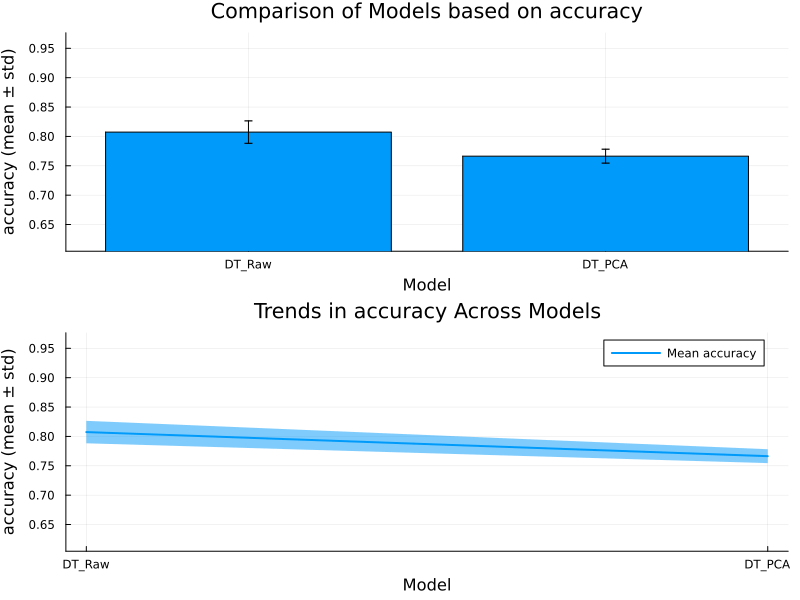

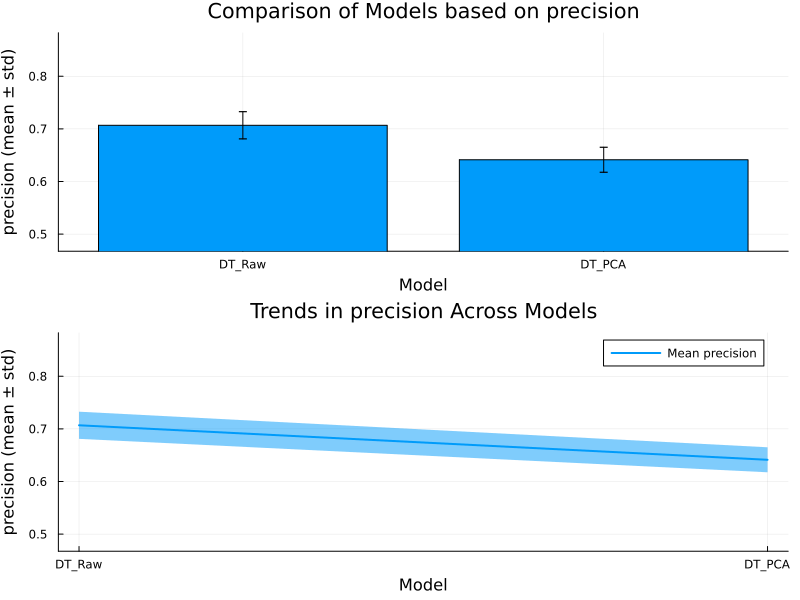

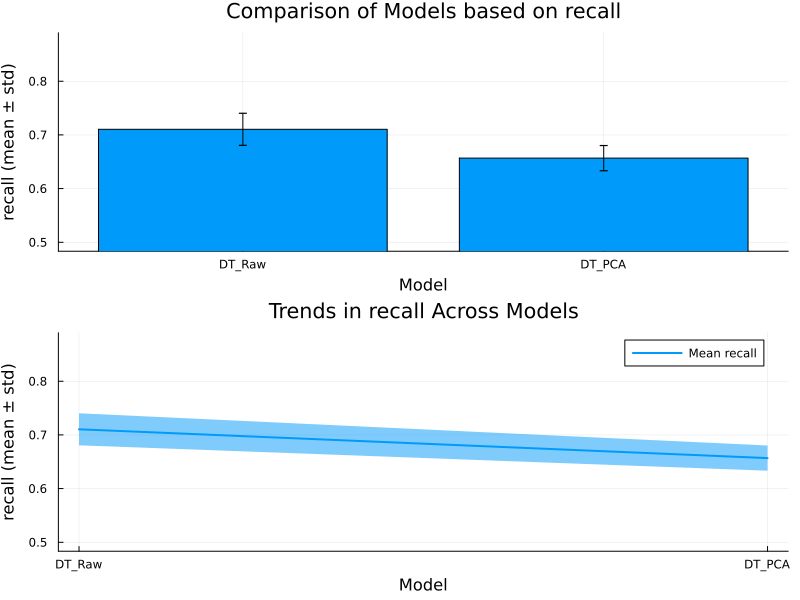

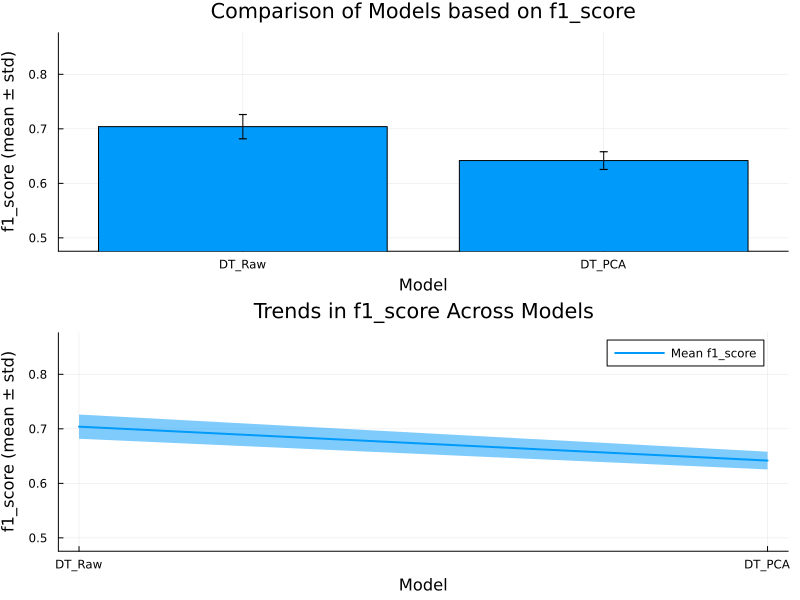

In [47]:
plotCombinedMetrics(model_names, metrics, metric_means, metric_stds, output_dir="./plots/Comparison_1_2/dt", show=true)

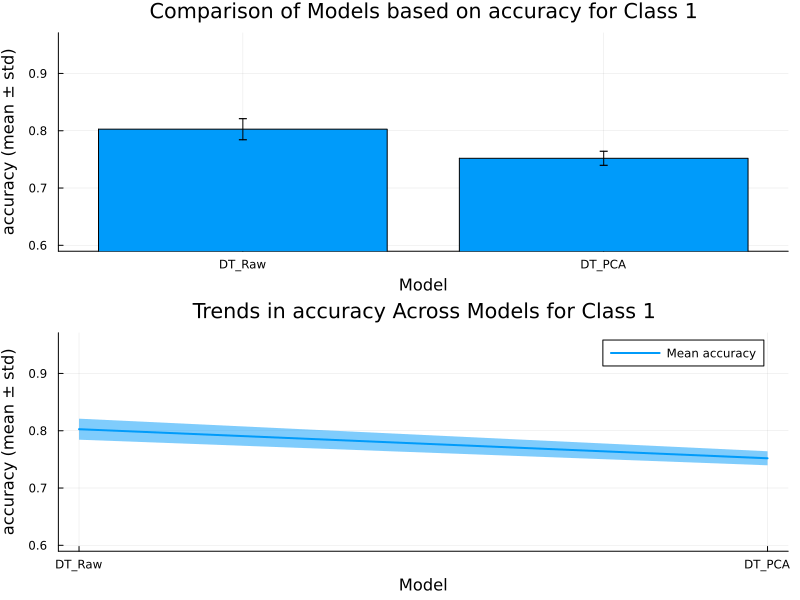

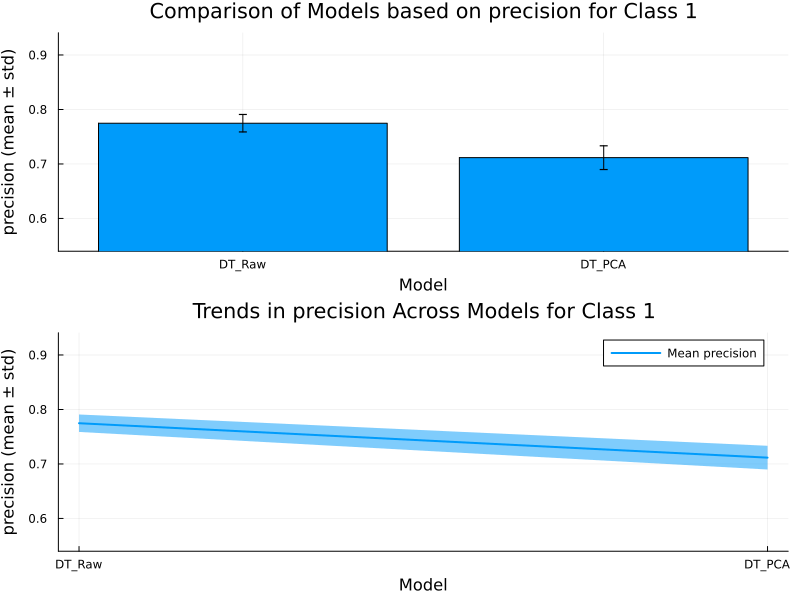

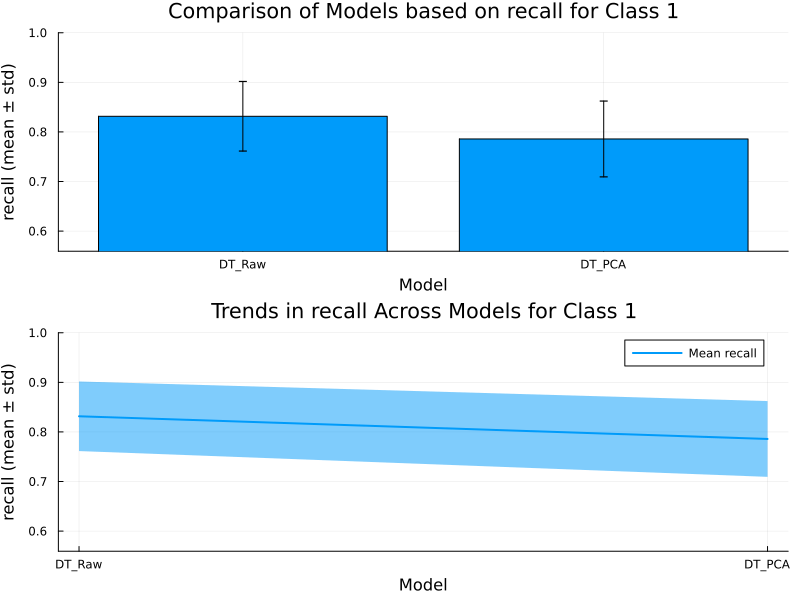

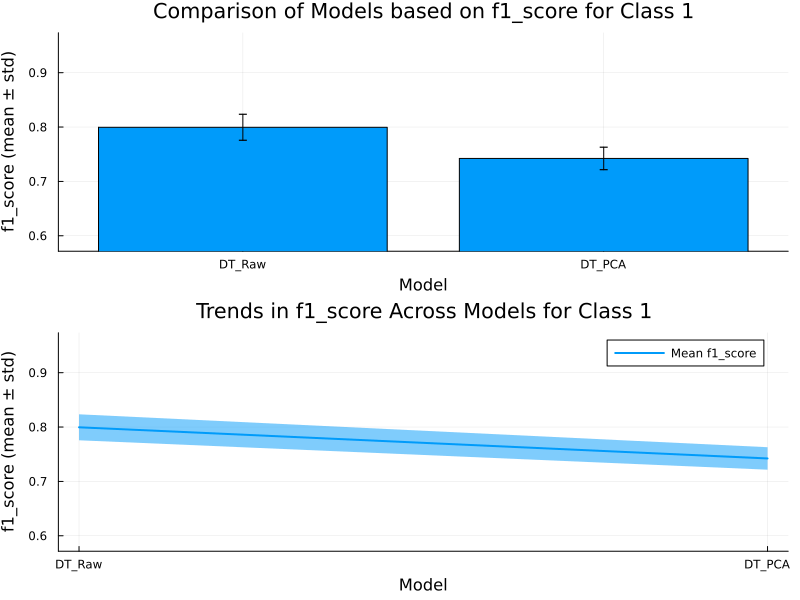

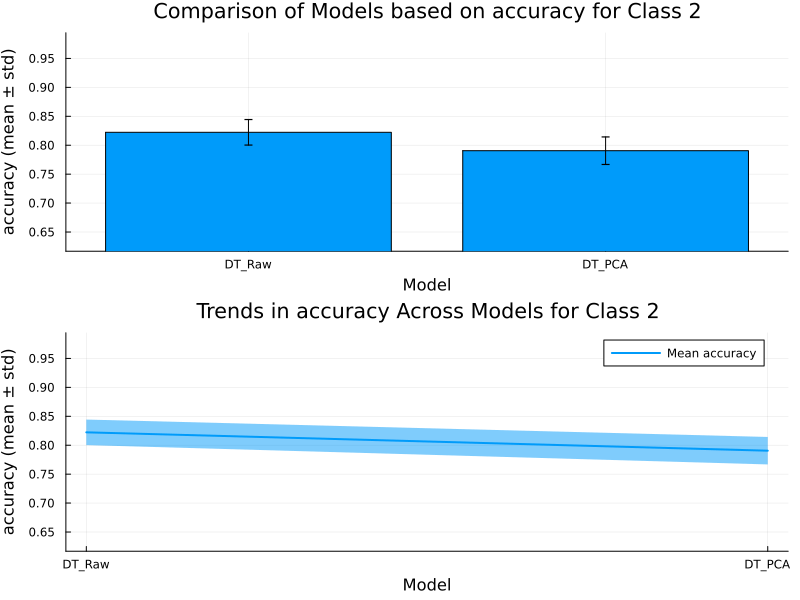

...

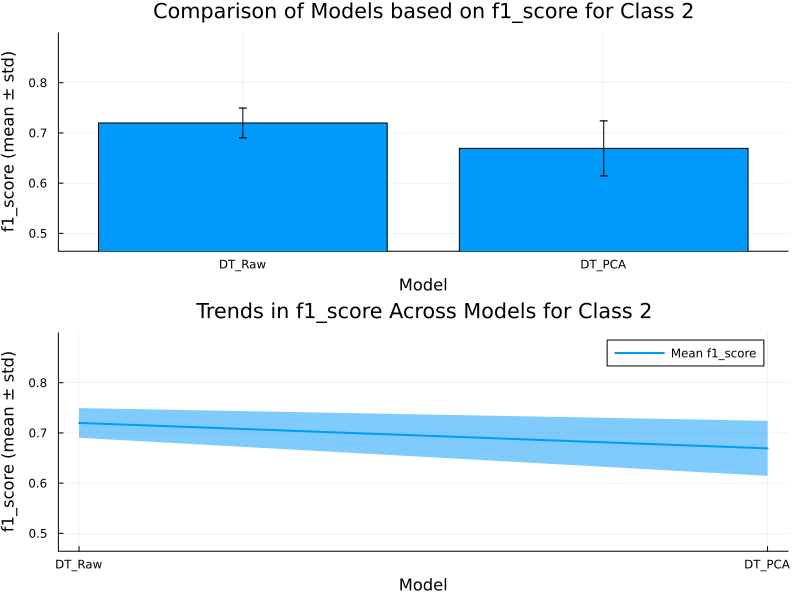

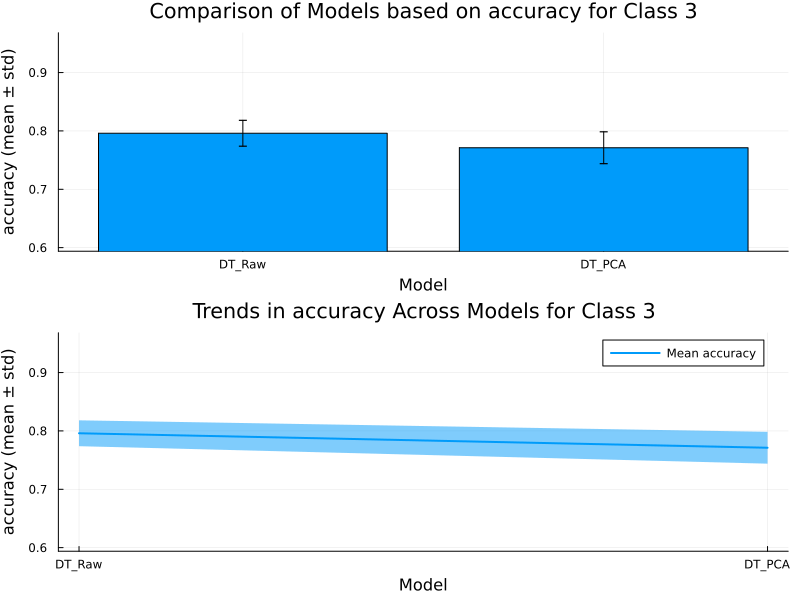

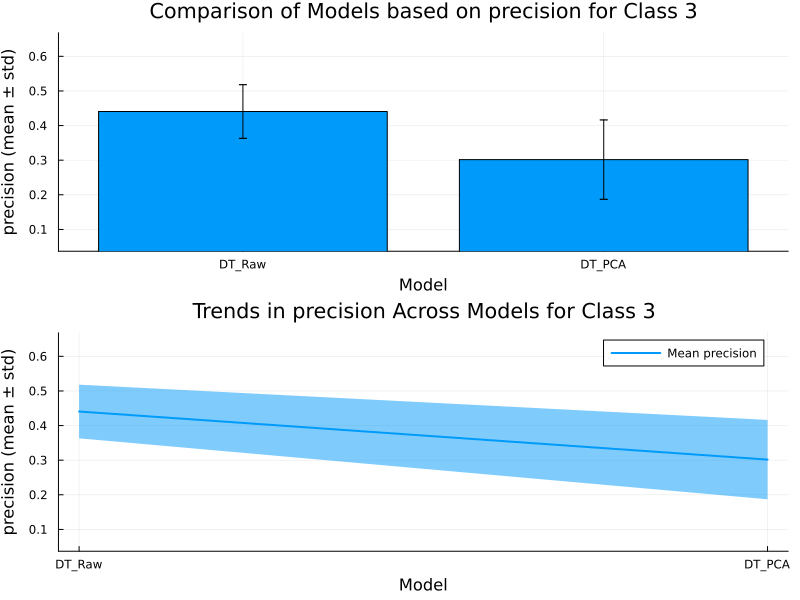

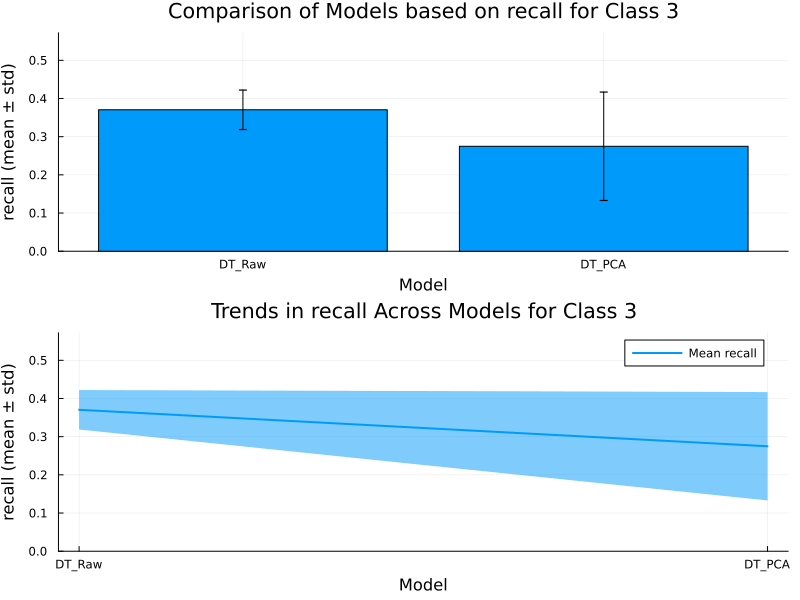

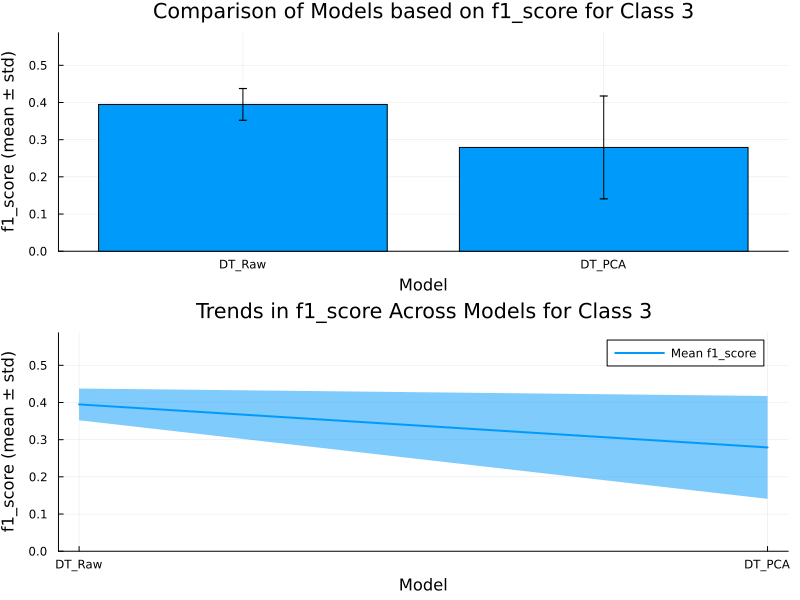

In [48]:
plotCombinedMetrics(model_names, 3, metrics, metric_means_class, metric_stds_class, output_dir="./plots/Comparison_1_2/dt/class", show=true)

In [49]:
generateComparisonTable(model_names, metrics, metric_maxes; output_dir="./tables/Comparison_1_2/dt",sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models (Sorted by f1_score):
┌────────┬──────────┬───────────┬────────┬──────────┐
│  Model │ Accuracy │ Precision │ Recall │ F1-Score │
├────────┼──────────┼───────────┼────────┼──────────┤
│ DT_Raw │    0.841 │     0.753 │   0.76 │    0.746 │
│ DT_PCA │    0.792 │     0.697 │  0.696 │    0.679 │
└────────┴──────────┴───────────┴────────┴──────────┘


In [50]:
generateComparisonTable(model_names, 3, metrics, metric_maxes_class; output_dir="./tables/Comparison_1_2/dt/class",sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models for Class 1 (Sorted by f1_score):
┌────────┬──────────┬───────────┬────────┬──────────┐
│  Model │ Accuracy │ Precision │ Recall │ F1-Score │
├────────┼──────────┼───────────┼────────┼──────────┤
│ DT_Raw │    0.854 │     0.818 │  0.971 │     0.85 │
│ DT_PCA │     0.84 │     0.799 │  0.975 │    0.791 │
└────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 2 (Sorted by f1_score):
┌────────┬──────────┬───────────┬────────┬──────────┐
│  Model │ Accuracy │ Precision │ Recall │ F1-Score │
├────────┼──────────┼───────────┼────────┼──────────┤
│ DT_Raw │    0.869 │     0.875 │  0.878 │     0.83 │
│ DT_PCA │    0.853 │     0.888 │  0.964 │    0.793 │
└────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 3 (Sorted by f1_score):
┌────────┬──────────┬───────────┬────────┬──────────┐
│  Model │ Accuracy │ Precision │ Recall │ F1-Score │
├──────

### K-Nearest Neighbors

In [51]:
model_names, metrics, metric_means, metric_stds, metric_means_class, metric_stds_class, metric_maxes, metric_maxes_class = aggregateMetrics(knn_obj, 3)

(Any["KNN_Raw", "KNN_PCA"], [:accuracy, :precision, :recall, :f1_score], Dict{Symbol, Vector{Any}}(:recall => [0.700920808564934, 0.6963463870421259], :f1_score => [0.680771268879236, 0.6757642716876461], :precision => [0.6848911752183879, 0.6784371428357339], :accuracy => [0.7957028128965732, 0.7927622101447931]), Dict{Symbol, Vector{Any}}(:recall => [0.015862732563750818, 0.02083831322733685], :f1_score => [0.008136177140295093, 0.01254295605556923], :precision => [0.013102985179236143, 0.016310765562525163], :accuracy => [0.009583598882581984, 0.012946865433036211]), Dict{Symbol, Vector{Any}}[Dict(:recall => [0.8467318511483969, 0.8282281377035428], :f1_score => [0.7803513991864375, 0.7719251704771783], :precision => [0.7337208466598337, 0.7330306633127571], :accuracy => [0.7858451552786588, 0.7860143314376249]), Dict(:recall => [0.6351683238890024, 0.7014367395009939], :f1_score => [0.6622489435175913, 0.7124698709175323], :precision => [0.7101833036133144, 0.7378734935133546], :ac

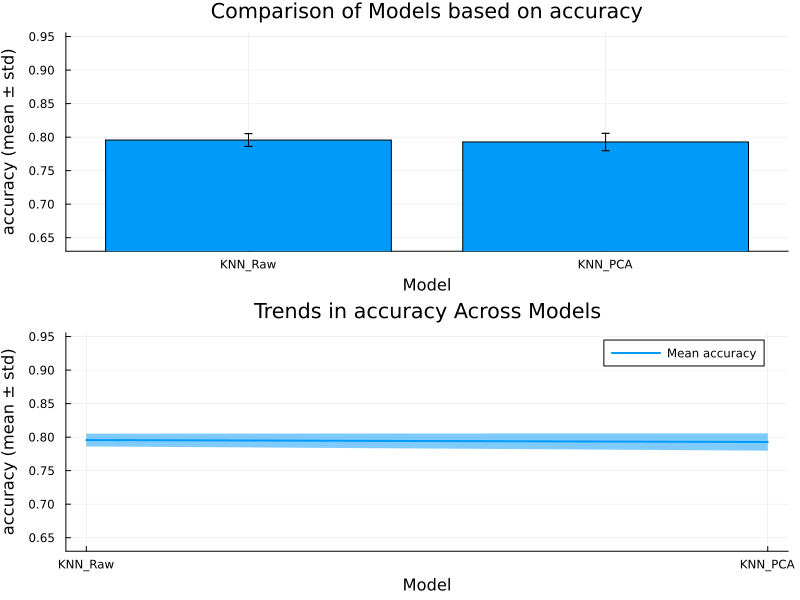

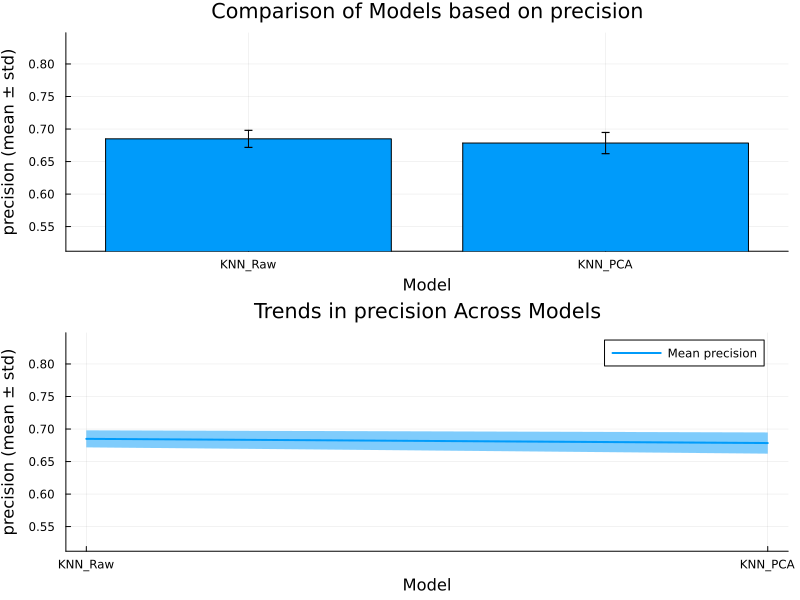

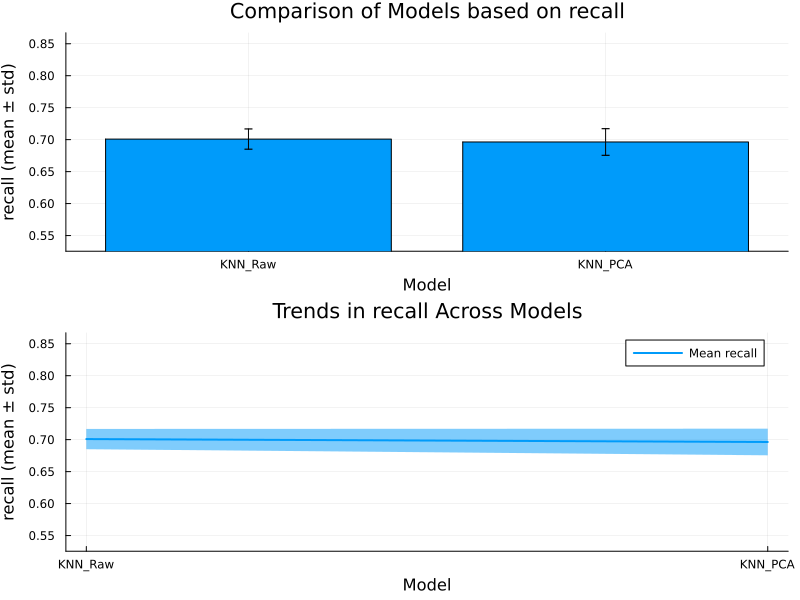

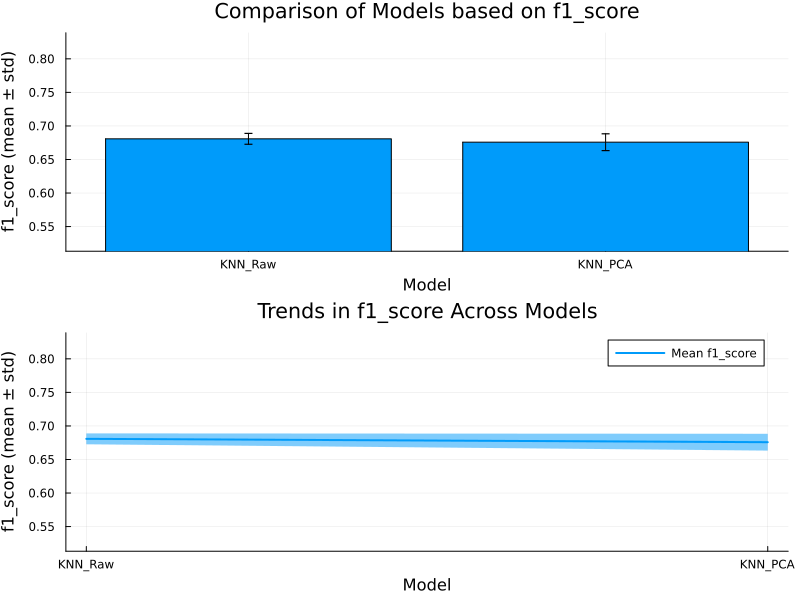

In [52]:
plotCombinedMetrics(model_names, metrics, metric_means, metric_stds, output_dir="./plots/Comparison_1_2/knn", show=true)

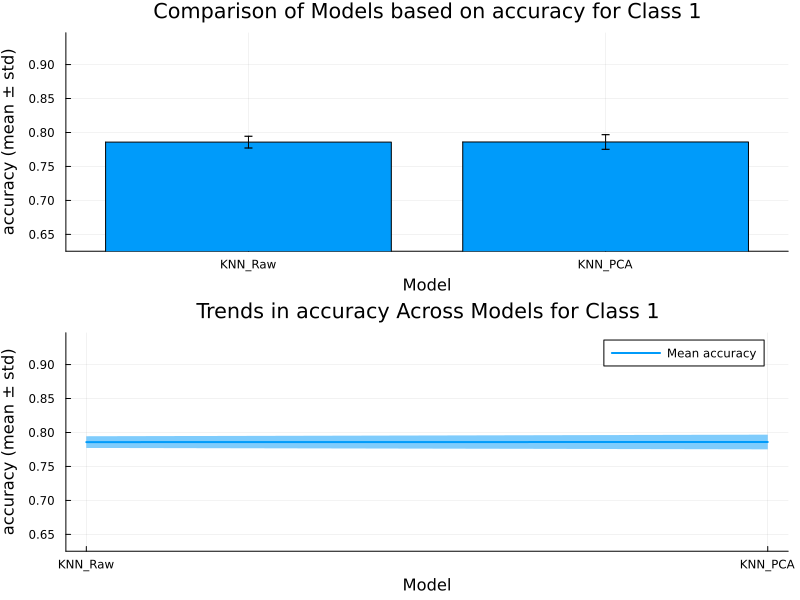

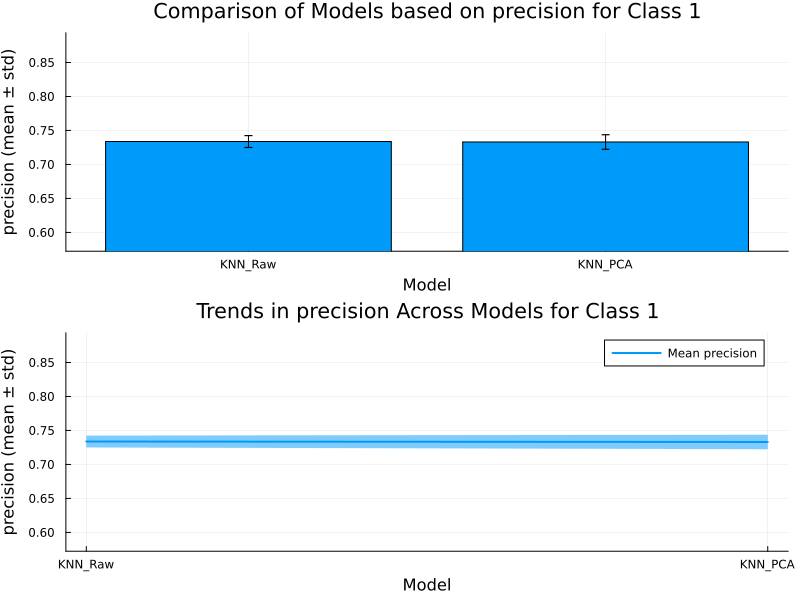

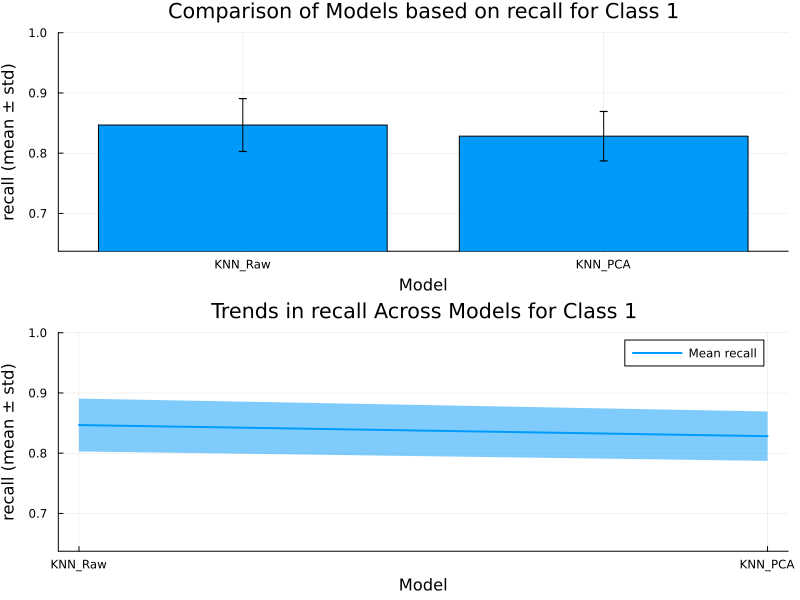

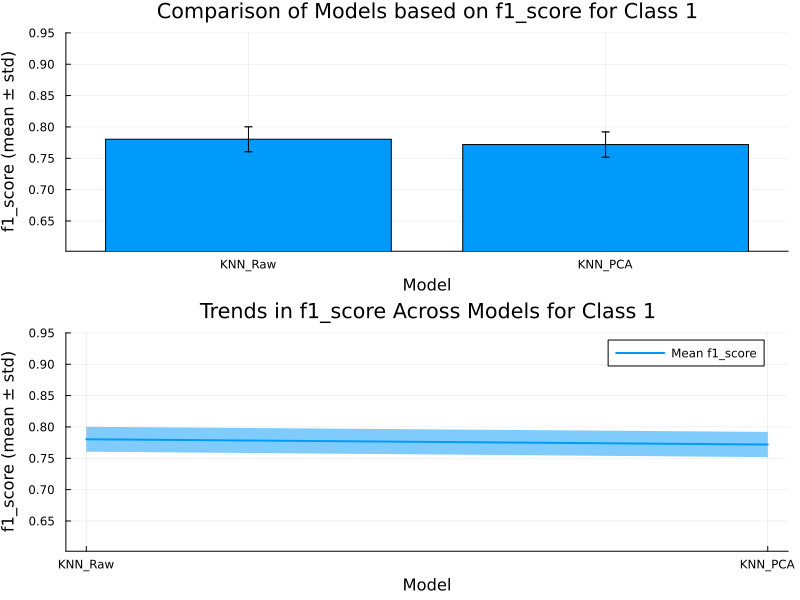

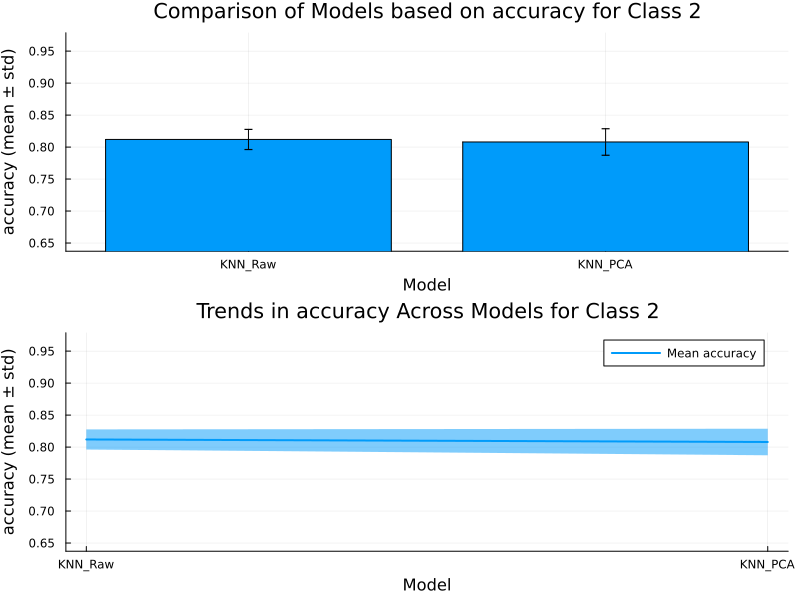

...

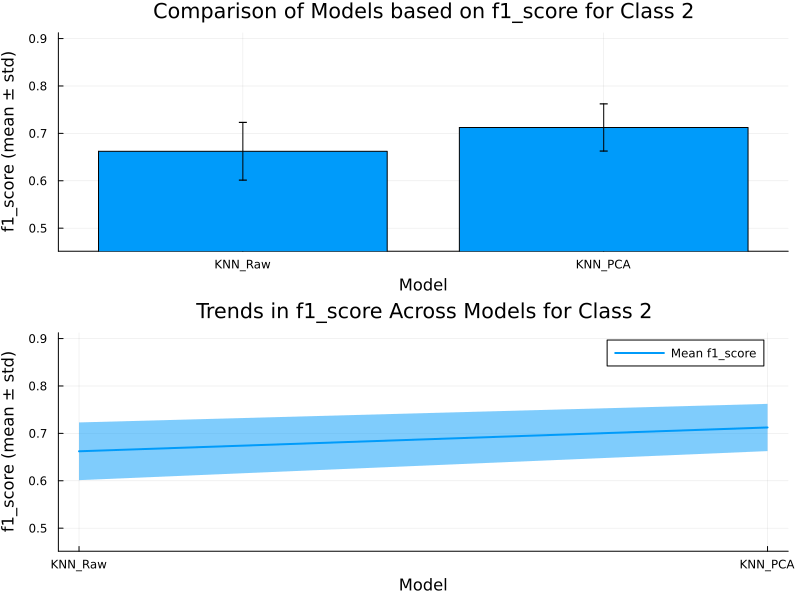

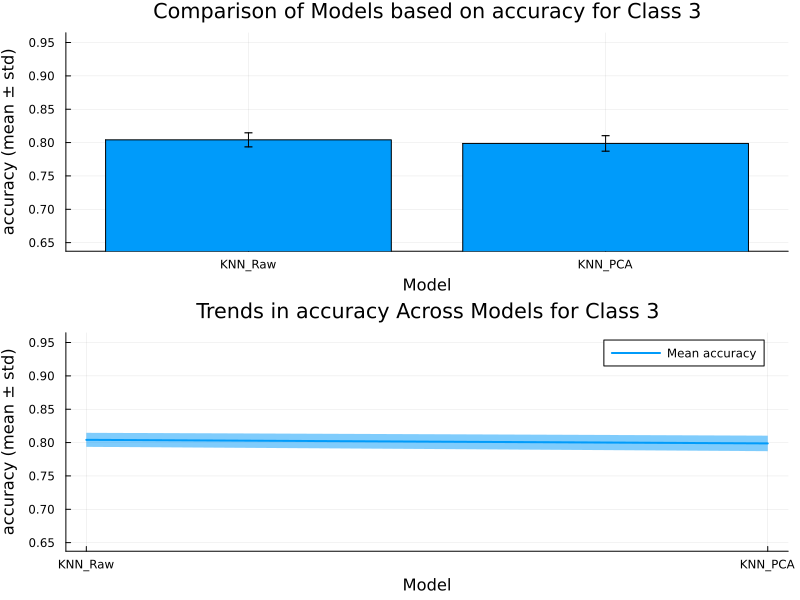

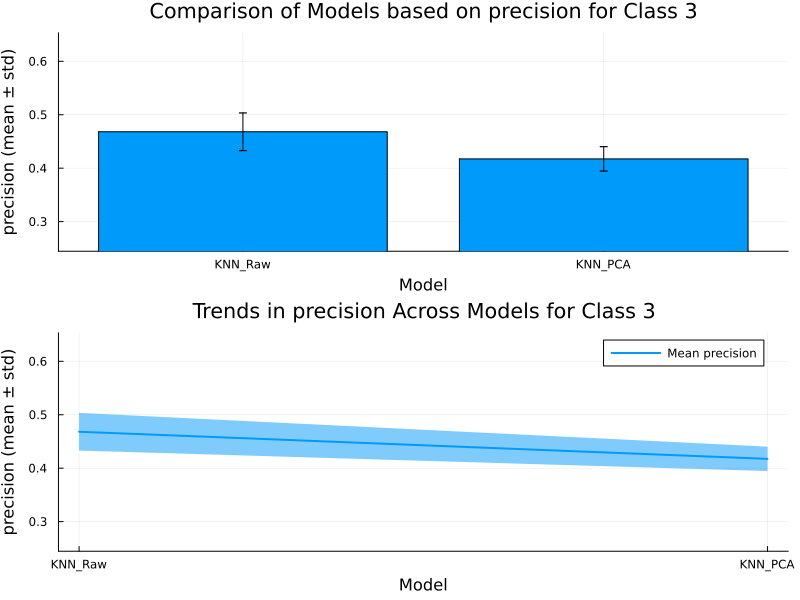

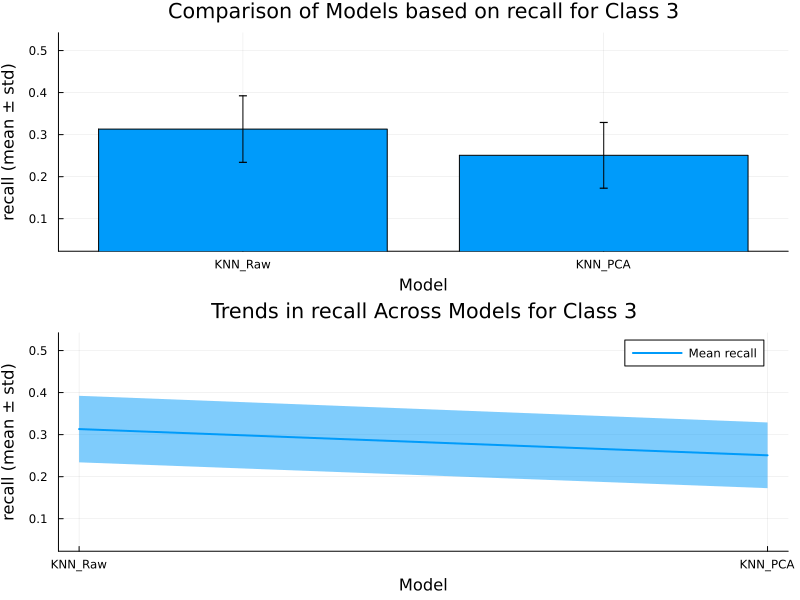

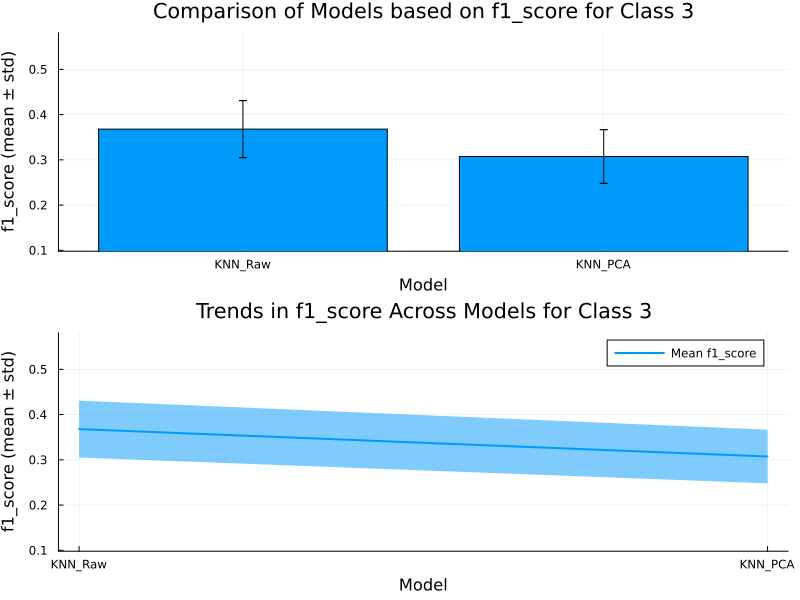

In [53]:
plotCombinedMetrics(model_names, 3, metrics, metric_means_class, metric_stds_class, output_dir="./plots/Comparison_1_2/knn/class", show=true)

In [54]:
generateComparisonTable(model_names, metrics, metric_maxes; output_dir="./tables/Comparison_1_2/knn",sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────┼──────────┼───────────┼────────┼──────────┤
│ KNN_Raw │    0.815 │     0.721 │  0.732 │    0.705 │
│ KNN_PCA │    0.818 │     0.721 │  0.736 │    0.705 │
└─────────┴──────────┴───────────┴────────┴──────────┘


In [55]:
generateComparisonTable(model_names, 3, metrics, metric_maxes_class; output_dir="./tables/Comparison_1_2/knn/class",sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models for Class 1 (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────┼──────────┼───────────┼────────┼──────────┤
│ KNN_Raw │    0.852 │     0.854 │  0.957 │     0.82 │
│ KNN_PCA │    0.846 │      0.83 │  0.962 │    0.819 │
└─────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 2 (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────┼──────────┼───────────┼────────┼──────────┤
│ KNN_PCA │    0.861 │     0.841 │  0.934 │    0.811 │
│ KNN_Raw │    0.859 │     0.849 │  0.937 │    0.808 │
└─────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 3 (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-S

### Support Vector Machine

In [56]:
model_names, metrics, metric_means, metric_stds, metric_means_class, metric_stds_class, metric_maxes, metric_maxes_class = aggregateMetrics(svm_obj, 3)

(Any["SVM_Raw", "SVM_PCA"], [:accuracy, :precision, :recall, :f1_score], Dict{Symbol, Vector{Any}}(:recall => [0.7240808543365684, 0.7123285772431823], :f1_score => [0.7030395492673542, 0.6935814289344159], :precision => [0.7168583890609663, 0.702929049577716], :accuracy => [0.8130746138106167, 0.8053476915676155]), Dict{Symbol, Vector{Any}}(:recall => [0.0432346267608621, 0.03804446301489743], :f1_score => [0.049873058304972316, 0.04029908680394169], :precision => [0.03432961191178266, 0.02795670627708305], :accuracy => [0.03270164120724798, 0.02705966815435445]), Dict{Symbol, Vector{Any}}[Dict(:recall => [0.8407286079232463, 0.8150326618580882], :f1_score => [0.7874167657143664, 0.7732232602712684], :precision => [0.7542113428097688, 0.7464987264797339], :accuracy => [0.811717742456253, 0.8062565592480029]), Dict(:recall => [0.7213315118827074, 0.7510469354847747], :f1_score => [0.7274475321082443, 0.749360141420217], :precision => [0.7548639076378748, 0.7645101028223342], :accuracy 

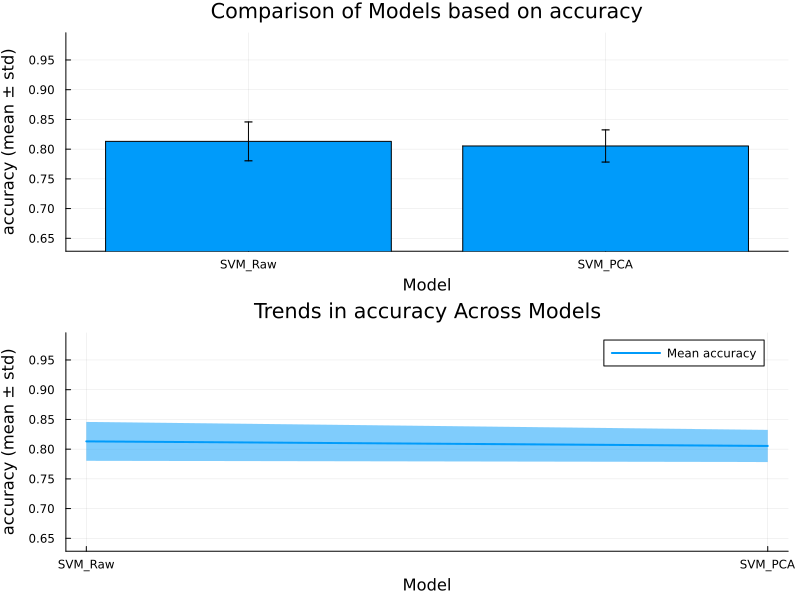

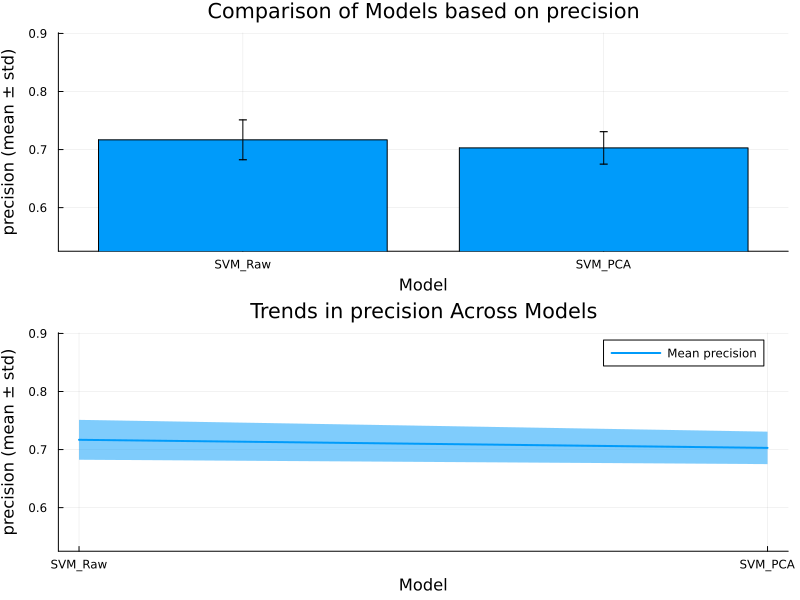

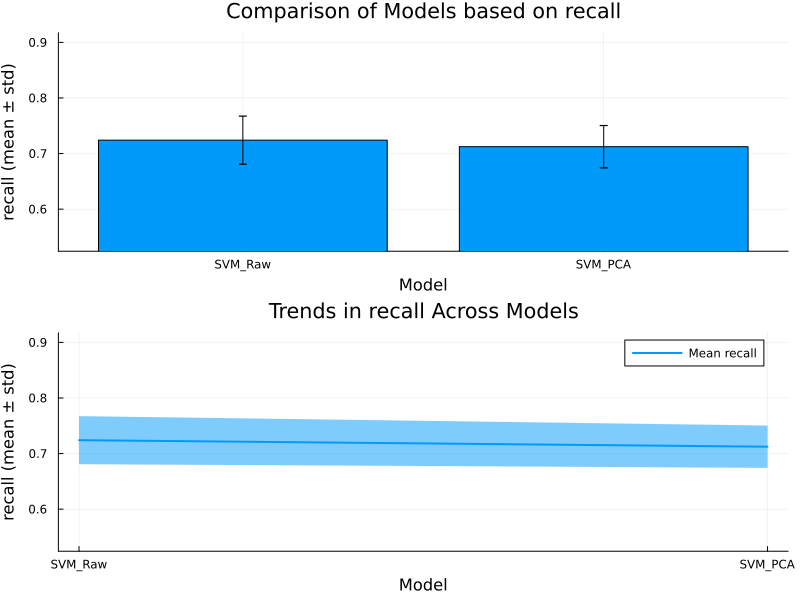

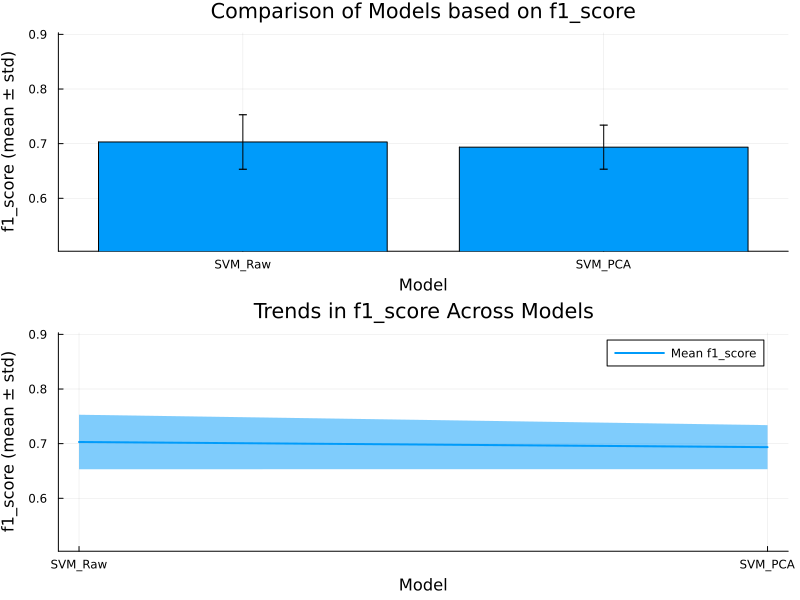

In [57]:
plotCombinedMetrics(model_names, metrics, metric_means, metric_stds, output_dir="./plots/Comparison_1_2/svm", show=true)

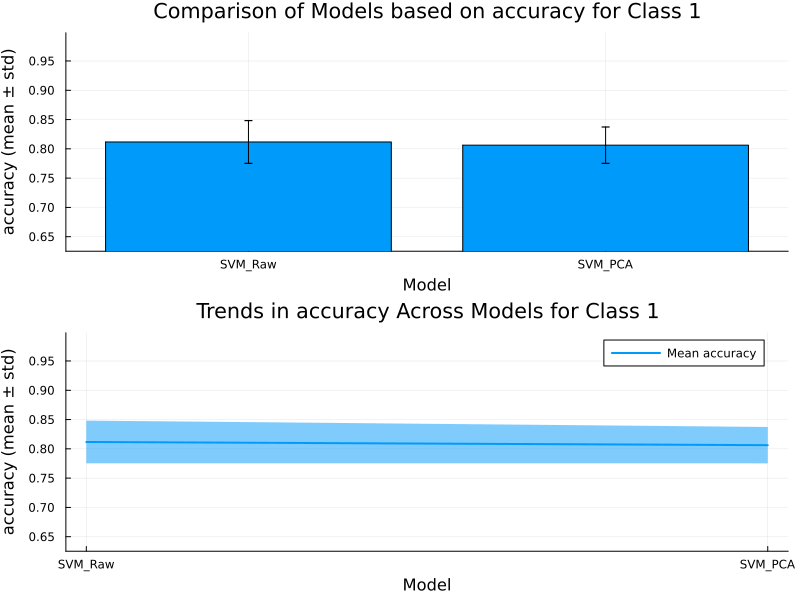

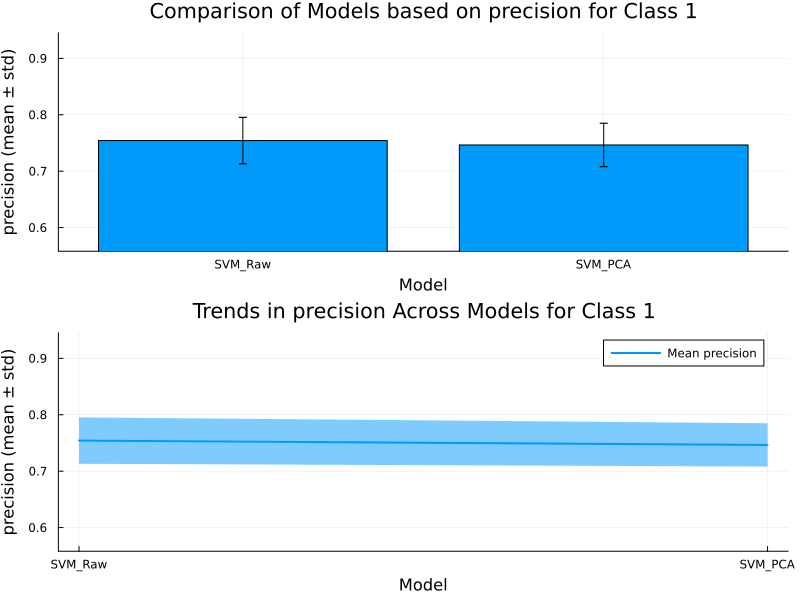

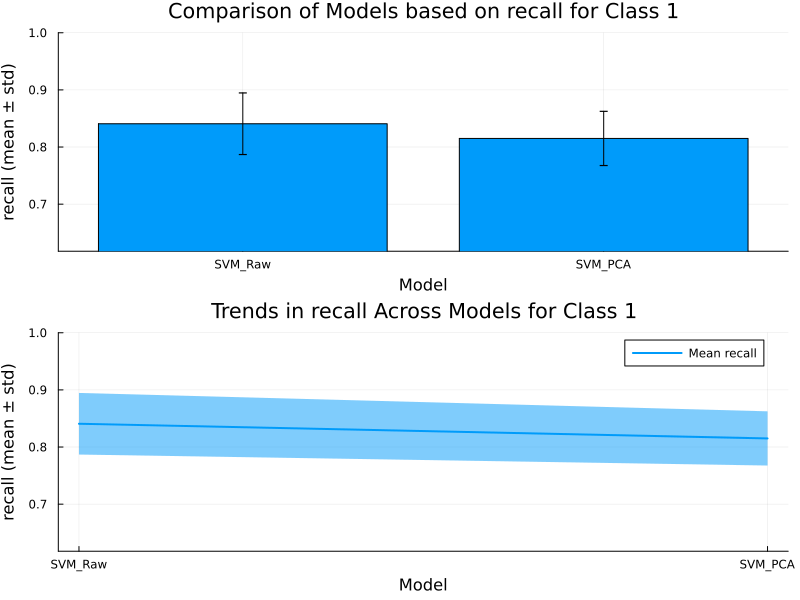

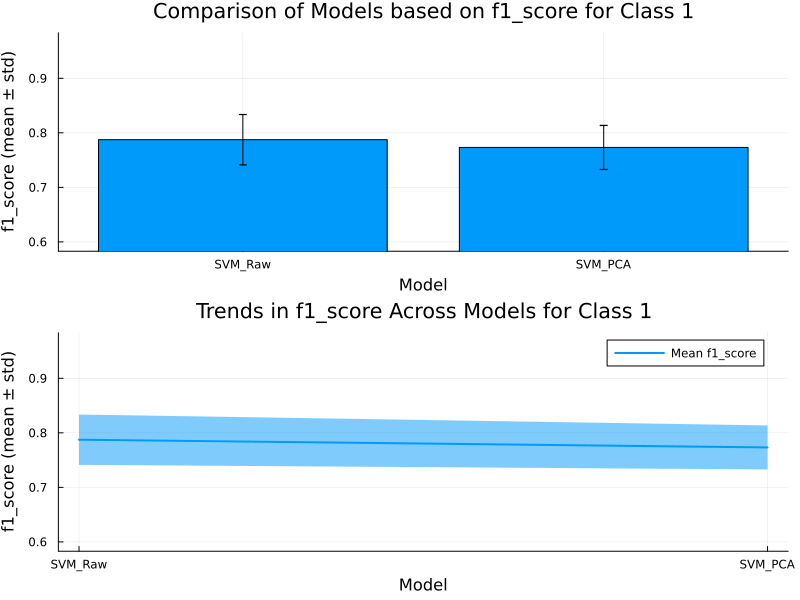

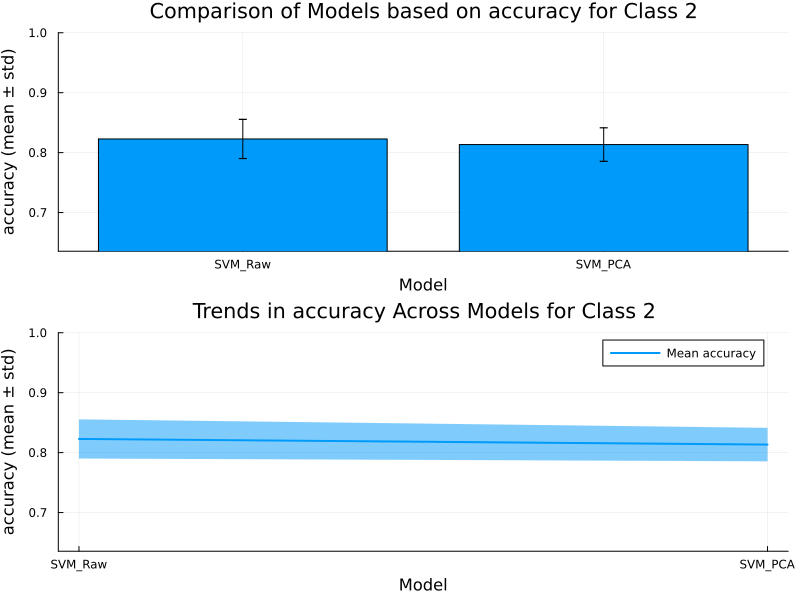

...

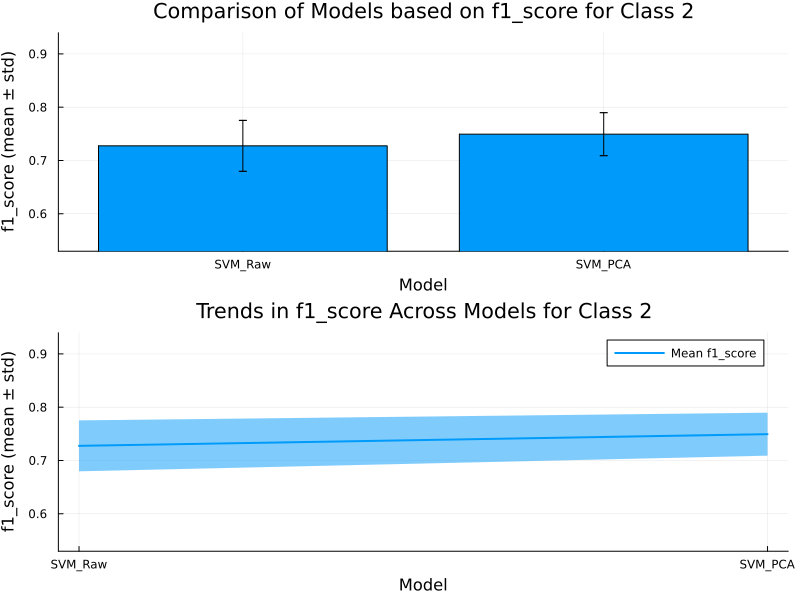

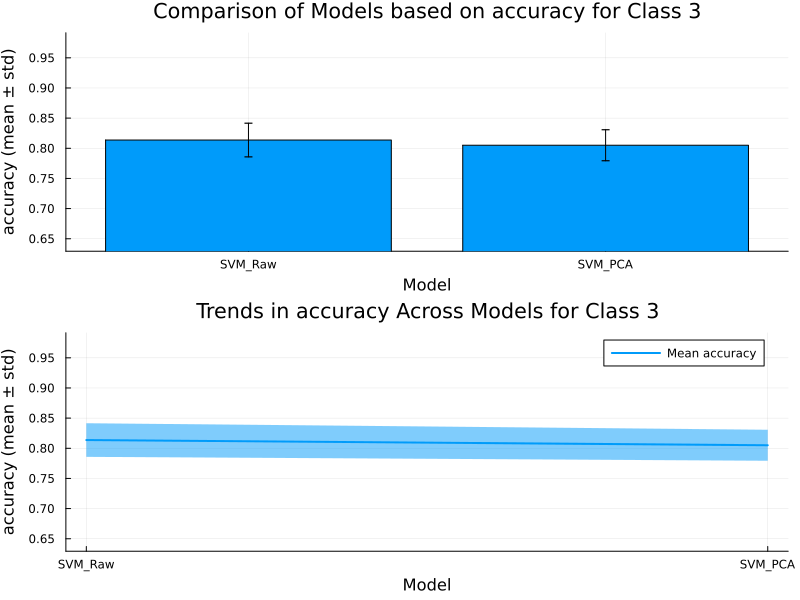

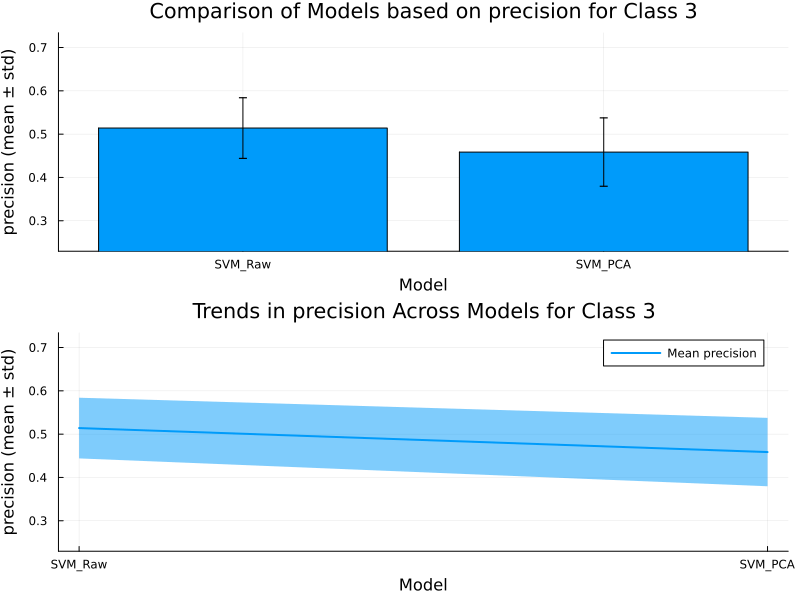

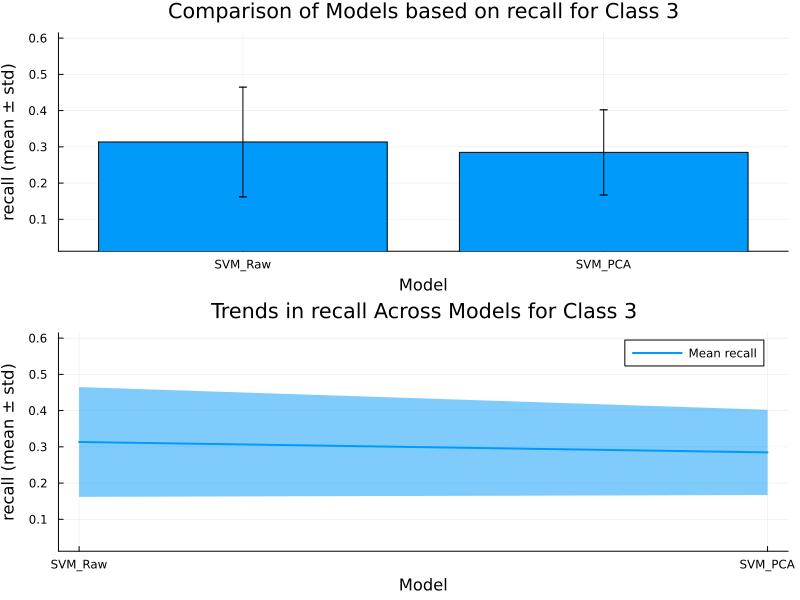

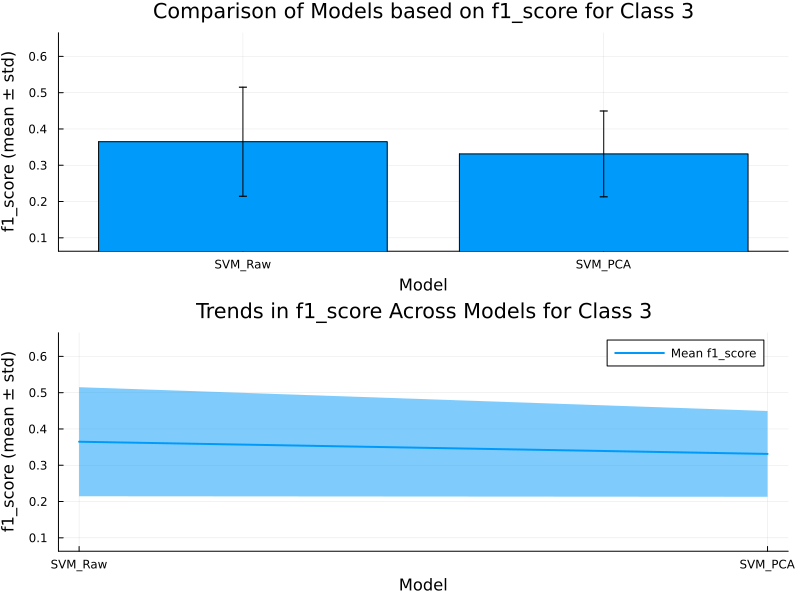

In [58]:
plotCombinedMetrics(model_names, 3, metrics, metric_means_class, metric_stds_class, output_dir="./plots/Comparison_1_2/svm/class", show=true)

In [59]:
generateComparisonTable(model_names, metrics, metric_maxes; output_dir="./tables/Comparison_1_2/svm",sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────┼──────────┼───────────┼────────┼──────────┤
│ SVM_Raw │    0.855 │     0.769 │   0.78 │    0.767 │
│ SVM_PCA │    0.842 │     0.747 │  0.762 │    0.745 │
└─────────┴──────────┴───────────┴────────┴──────────┘


In [60]:
generateComparisonTable(model_names, 3, metrics, metric_maxes_class; output_dir="./tables/Comparison_1_2/svm/class",sort_by=:f1_score, rev=true)


Comparison of Maximum Metrics Across Models for Class 1 (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────┼──────────┼───────────┼────────┼──────────┤
│ SVM_Raw │    0.882 │     0.888 │  0.984 │    0.854 │
│ SVM_PCA │    0.861 │      0.87 │  0.975 │    0.846 │
└─────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 2 (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-Score │
├─────────┼──────────┼───────────┼────────┼──────────┤
│ SVM_Raw │     0.88 │     0.905 │  0.966 │    0.863 │
│ SVM_PCA │     0.87 │      0.88 │  0.964 │    0.842 │
└─────────┴──────────┴───────────┴────────┴──────────┘

Comparison of Maximum Metrics Across Models for Class 3 (Sorted by f1_score):
┌─────────┬──────────┬───────────┬────────┬──────────┐
│   Model │ Accuracy │ Precision │ Recall │ F1-S